# Finding a latent space representation for Japanese Idols
### WIth feature, pixel, and target propagation loss
### And automatic cropping with dlib
### Constraining input to be orthogonal
### Using the FaceSpace API

In [1]:
%load_ext autoreload
%autoreload 2
from FaceSpace import PreprocessFaceDir, MakeFaceData, MakeFaceModel, TrainFaceModel
from FaceSpace import SaveFaceSpace, LoadFaceSpace, GetFaceFromZSpace, ShowFace 

### 1. Preprocess raw photos to get cropped, aligned photos

In [2]:
RawImagesPath = 'Idol FaceSpace/images'
AlignedImagesPath = 'Idol FaceSpace/images/aligned'
PreprocessFaceDir(RawImagesPath, AlignedImagesPath)

### 2. Make FaceData object based on aligned images
#### FaceData contains Zspace (one-hot encoded, orthogonal vectors for each face), a to-be-learned Wspace, tensor representations of faces, and feature maps of faces

Getting tensors of (aligned) face images
ZDims unspecified, will be inferred from number of images provided.
Zdims set equal to Size:  8
Using default Zspace - identity matrix (orthogonal vectors) of dim  8
Using default Wspace - zero matrix of dim  8


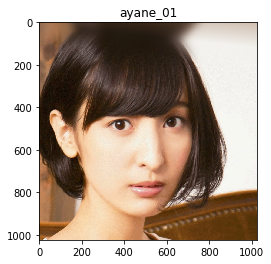

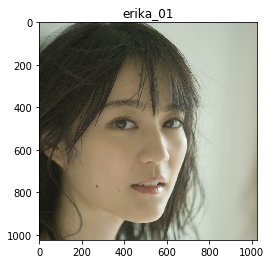

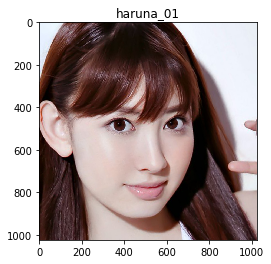

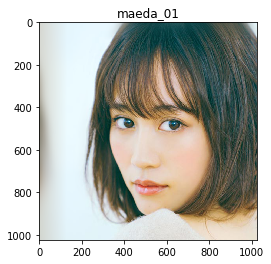

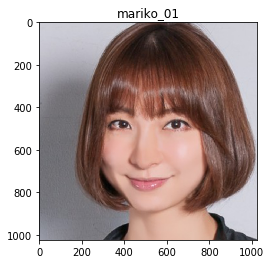

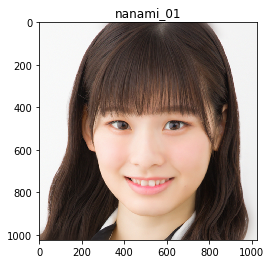

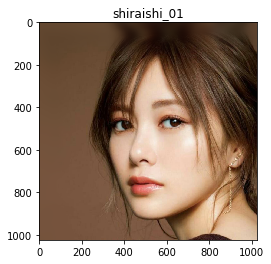

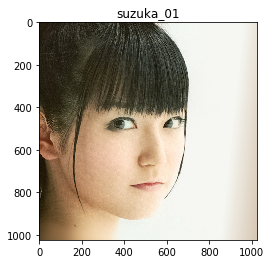

Reshaped Wspace to match number of stored faces, Wspace dim:  torch.Size([8, 18, 512])
Setting Wspaces to be the mean latent vector from  W_mean.pt


In [2]:
FaceData = MakeFaceData('Idol FaceSpace/images/aligned')

### 3. Make FaceModel based on FaceData object
#### FaceModel is a StyleGAN with the mapping network replaced with a decompression encoder

In [3]:
FaceModel = MakeFaceModel(FaceData)

No Zdims explicitly specified, inferring Zdims from FaceData, Zdims=8


### 4. Train the FaceModel to map orthogonal Zspace to an extended Wspace using feature, pixel, and target propagation loss using a learned Wspace

Note: No FeatureMaps stored in FaceData, will extract target feature maps each batch
Training for basis face encoding (synthetic face generation)
Training with target propagation loss only for this initial phase.


/home/tsehao/anaconda3/envs/tth20191007/lib/python3.7/site-packages/torch/nn/functional.py:2479: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


Epoch:  1
Batch:  1
This batch:  ['maeda_01', 'nanami_01']
Total time elapsed:  0.7273187637329102  s
Feature loss:  143.67642211914062  | Pixel loss:  0.1775839477777481  | Target prop loss:  1.1223738193511963
Weighted - Feature loss:  14367.642211914062  | Pixel loss:  17.75839477777481  | Target prop loss:  11223.738193511963
Total loss:  25609.140625


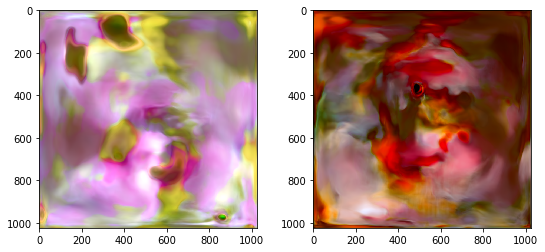

Target W+ output
W+ loss:  9975.7431640625


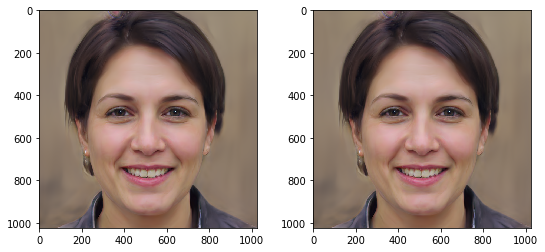

Epoch:  1
Batch:  2
This batch:  ['erika_01', 'suzuka_01']
Total time elapsed:  2.0893421173095703  s
Feature loss:  93.9643783569336  | Pixel loss:  0.20962052047252655  | Target prop loss:  0.7145354151725769
Weighted - Feature loss:  9396.43783569336  | Pixel loss:  20.962052047252655  | Target prop loss:  7145.354151725769
Total loss:  16562.75390625


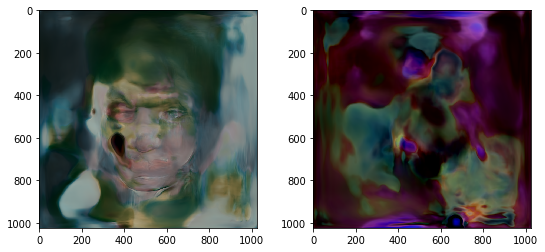

Target W+ output
W+ loss:  8637.57421875


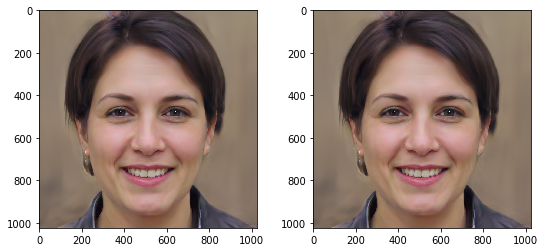

Epoch:  1
Batch:  3
This batch:  ['shiraishi_01', 'haruna_01']
Total time elapsed:  3.45977783203125  s
Feature loss:  124.1847915649414  | Pixel loss:  0.17668861150741577  | Target prop loss:  1.634704828262329
Weighted - Feature loss:  12418.47915649414  | Pixel loss:  17.668861150741577  | Target prop loss:  16347.048282623291
Total loss:  28783.1953125


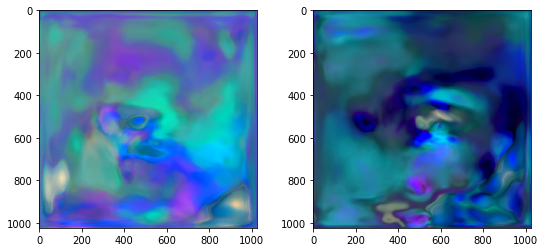

Target W+ output
W+ loss:  11242.375


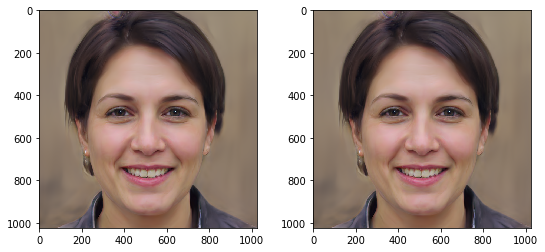

Epoch:  1
Batch:  4
This batch:  ['mariko_01', 'ayane_01']
Total time elapsed:  4.746899843215942  s
Feature loss:  104.99471282958984  | Pixel loss:  0.2623196244239807  | Target prop loss:  2.285874366760254
Weighted - Feature loss:  10499.471282958984  | Pixel loss:  26.23196244239807  | Target prop loss:  22858.74366760254
Total loss:  33384.44921875


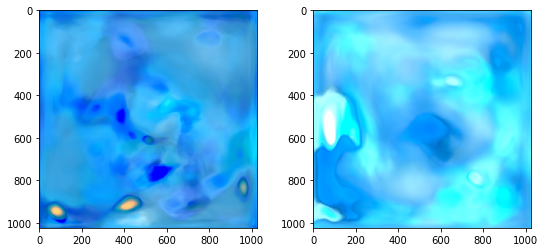

Target W+ output
W+ loss:  9802.0390625


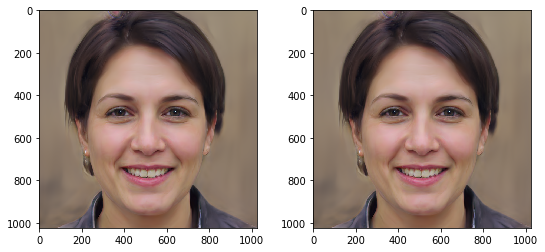

Epoch:  25
Batch:  1
This batch:  ['shiraishi_01', 'haruna_01']
Total time elapsed:  53.41783666610718  s
Feature loss:  70.01454162597656  | Pixel loss:  0.07523012161254883  | Target prop loss:  0.03131919354200363
Weighted - Feature loss:  7001.454162597656  | Pixel loss:  7.523012161254883  | Target prop loss:  313.1919354200363
Total loss:  7322.1689453125


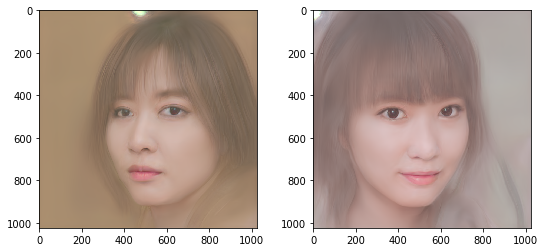

Target W+ output
W+ loss:  6823.70263671875


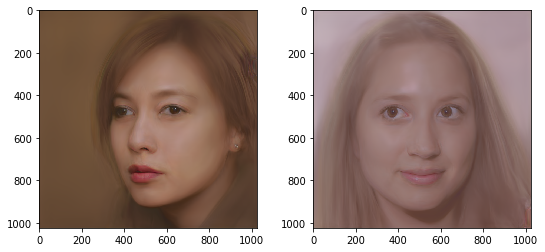

Epoch:  25
Batch:  2
This batch:  ['ayane_01', 'erika_01']
Total time elapsed:  54.8285026550293  s
Feature loss:  55.82625961303711  | Pixel loss:  0.06244818866252899  | Target prop loss:  0.026994112879037857
Weighted - Feature loss:  5582.625961303711  | Pixel loss:  6.244818866252899  | Target prop loss:  269.94112879037857
Total loss:  5858.8115234375


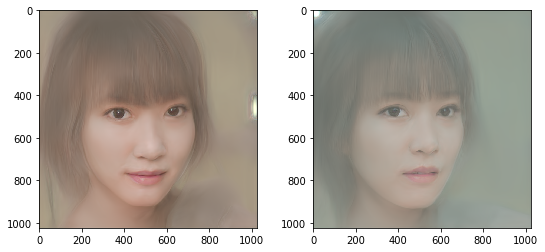

Target W+ output
W+ loss:  5383.68212890625


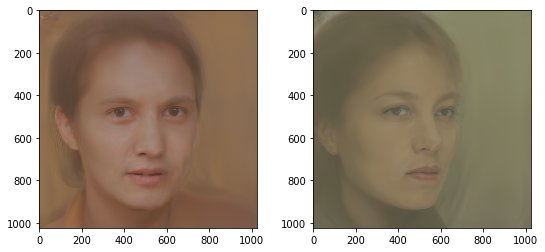

Epoch:  25
Batch:  3
This batch:  ['mariko_01', 'nanami_01']
Total time elapsed:  56.16426420211792  s
Feature loss:  54.66946029663086  | Pixel loss:  0.06017737463116646  | Target prop loss:  0.028395870700478554
Weighted - Feature loss:  5466.946029663086  | Pixel loss:  6.017737463116646  | Target prop loss:  283.95870700478554
Total loss:  5756.921875


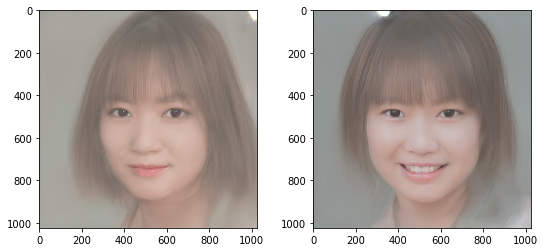

Target W+ output
W+ loss:  5056.5205078125


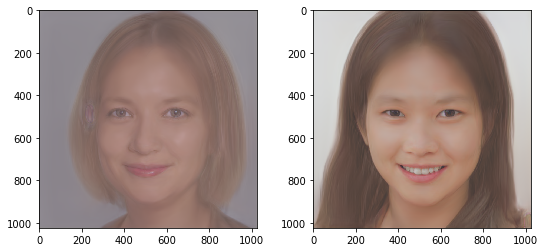

Epoch:  25
Batch:  4
This batch:  ['maeda_01', 'suzuka_01']
Total time elapsed:  57.5000536441803  s
Feature loss:  47.426151275634766  | Pixel loss:  0.08155044168233871  | Target prop loss:  0.03024301864206791
Weighted - Feature loss:  4742.615127563477  | Pixel loss:  8.155044168233871  | Target prop loss:  302.4301864206791
Total loss:  5053.20068359375


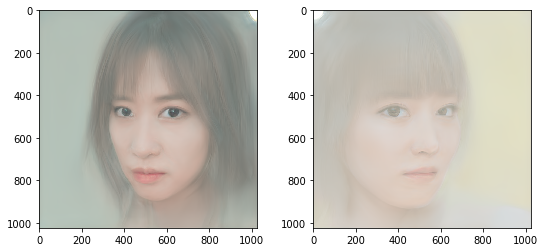

Target W+ output
W+ loss:  4849.626953125


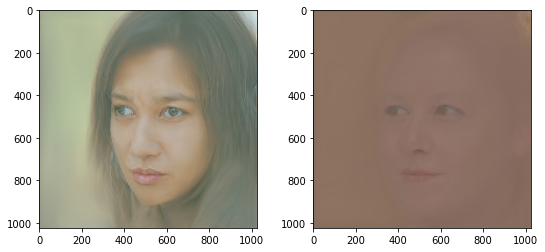

Epoch:  50
Batch:  1
This batch:  ['mariko_01', 'maeda_01']
Total time elapsed:  109.579176902771  s
Feature loss:  42.99599075317383  | Pixel loss:  0.03176628425717354  | Target prop loss:  0.033038899302482605
Weighted - Feature loss:  4299.599075317383  | Pixel loss:  3.176628425717354  | Target prop loss:  330.38899302482605
Total loss:  4633.1650390625


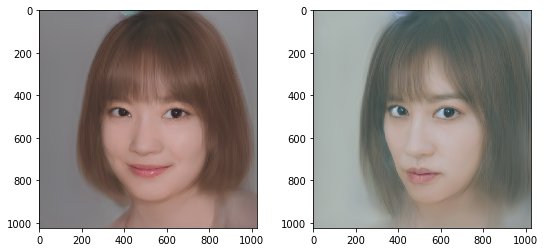

Target W+ output
W+ loss:  4275.81640625


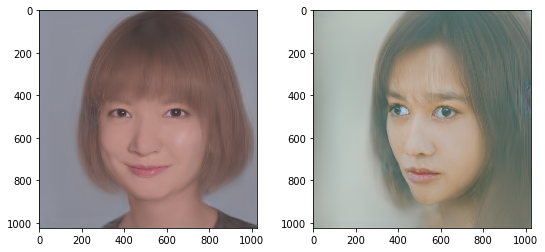

Epoch:  50
Batch:  2
This batch:  ['erika_01', 'ayane_01']
Total time elapsed:  110.93051648139954  s
Feature loss:  46.77287292480469  | Pixel loss:  0.04111984744668007  | Target prop loss:  0.03046991489827633
Weighted - Feature loss:  4677.287292480469  | Pixel loss:  4.111984744668007  | Target prop loss:  304.6991489827633
Total loss:  4986.09814453125


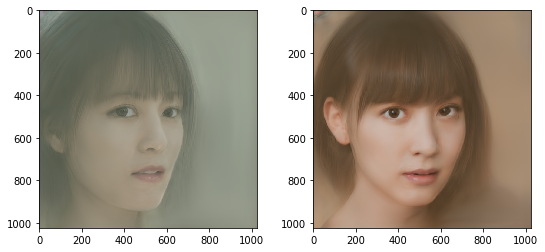

Target W+ output
W+ loss:  4489.7548828125


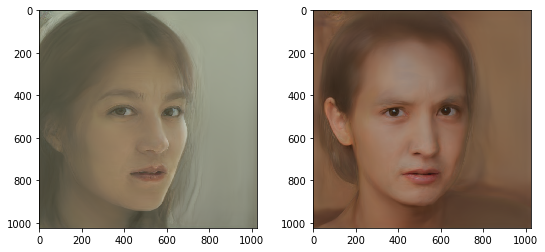

Epoch:  50
Batch:  3
This batch:  ['nanami_01', 'haruna_01']
Total time elapsed:  112.24282598495483  s
Feature loss:  67.45640563964844  | Pixel loss:  0.05956067144870758  | Target prop loss:  0.03909887745976448
Weighted - Feature loss:  6745.640563964844  | Pixel loss:  5.956067144870758  | Target prop loss:  390.9887745976448
Total loss:  7142.58544921875


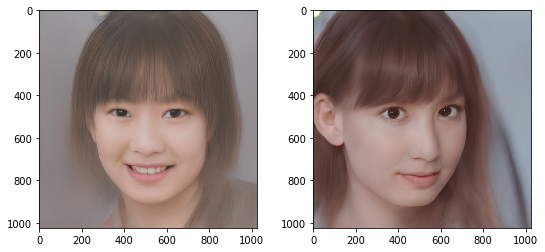

Target W+ output
W+ loss:  6253.69775390625


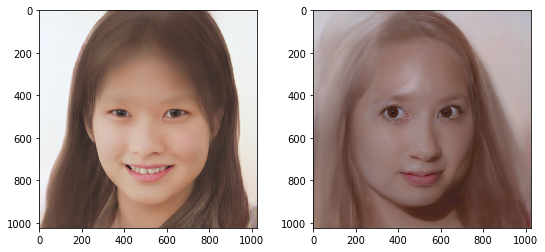

Epoch:  50
Batch:  4
This batch:  ['suzuka_01', 'shiraishi_01']
Total time elapsed:  113.61997032165527  s
Feature loss:  39.2520866394043  | Pixel loss:  0.04321668669581413  | Target prop loss:  0.03466144576668739
Weighted - Feature loss:  3925.2086639404297  | Pixel loss:  4.321668669581413  | Target prop loss:  346.61445766687393
Total loss:  4276.14501953125


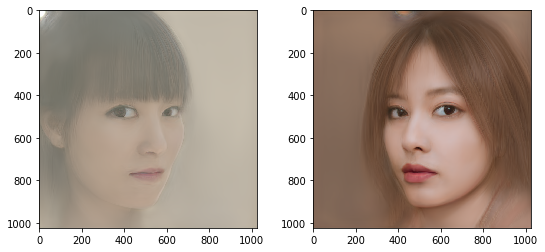

Target W+ output
W+ loss:  4056.433837890625


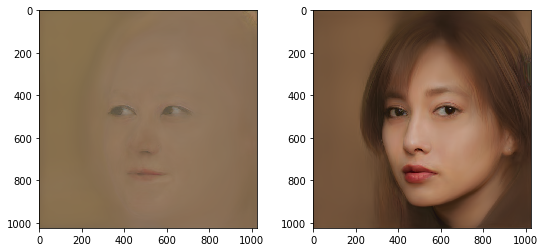

Epoch:  75
Batch:  1
This batch:  ['suzuka_01', 'erika_01']
Total time elapsed:  165.8562216758728  s
Feature loss:  31.52607536315918  | Pixel loss:  0.033156897872686386  | Target prop loss:  0.033702198415994644
Weighted - Feature loss:  3152.607536315918  | Pixel loss:  3.3156897872686386  | Target prop loss:  337.02198415994644
Total loss:  3492.945068359375


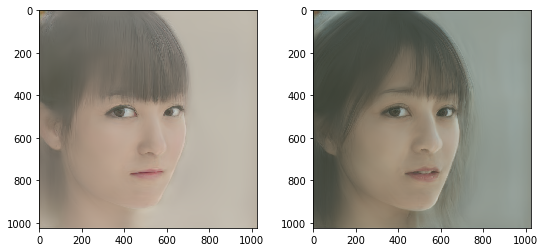

Target W+ output
W+ loss:  3558.7392578125


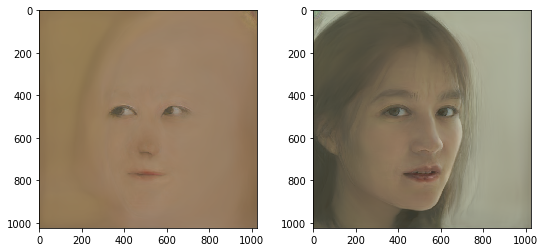

Epoch:  75
Batch:  2
This batch:  ['maeda_01', 'ayane_01']
Total time elapsed:  167.17608547210693  s
Feature loss:  50.558616638183594  | Pixel loss:  0.03907996788620949  | Target prop loss:  0.040491241961717606
Weighted - Feature loss:  5055.861663818359  | Pixel loss:  3.907996788620949  | Target prop loss:  404.91241961717606
Total loss:  5464.6826171875


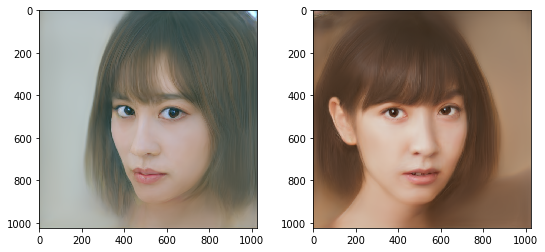

Target W+ output
W+ loss:  4472.27197265625


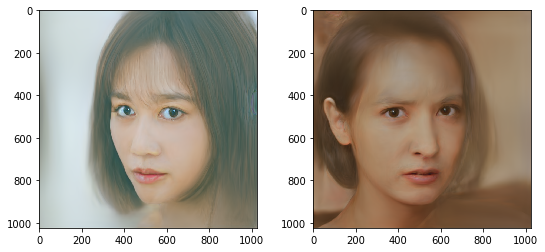

Epoch:  75
Batch:  3
This batch:  ['mariko_01', 'haruna_01']
Total time elapsed:  168.5619342327118  s
Feature loss:  51.52483367919922  | Pixel loss:  0.027595682069659233  | Target prop loss:  0.040380846709012985
Weighted - Feature loss:  5152.483367919922  | Pixel loss:  2.7595682069659233  | Target prop loss:  403.80846709012985
Total loss:  5559.0517578125


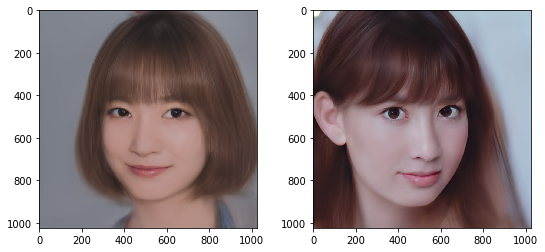

Target W+ output
W+ loss:  5286.12060546875


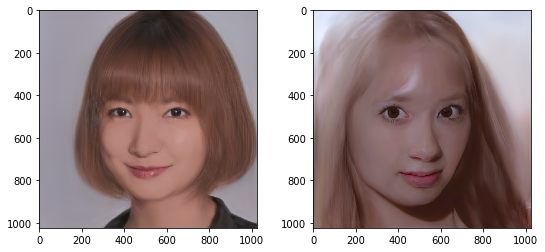

Epoch:  75
Batch:  4
This batch:  ['shiraishi_01', 'nanami_01']
Total time elapsed:  169.9445765018463  s
Feature loss:  46.41557312011719  | Pixel loss:  0.0309161264449358  | Target prop loss:  0.04303876683115959
Weighted - Feature loss:  4641.557312011719  | Pixel loss:  3.09161264449358  | Target prop loss:  430.3876683115959
Total loss:  5075.03662109375


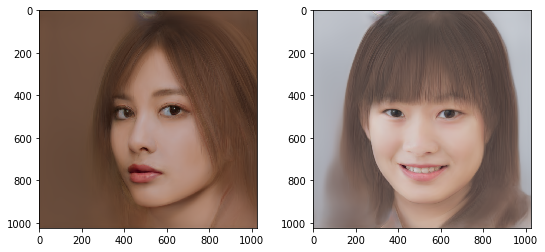

Target W+ output
W+ loss:  3792.341796875


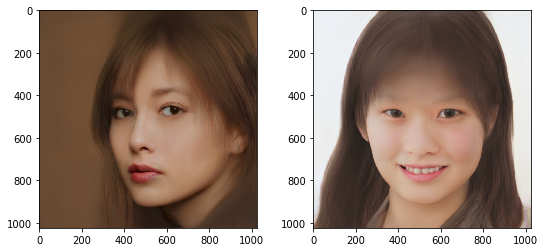

Epoch:  100
Batch:  1
This batch:  ['suzuka_01', 'erika_01']
Total time elapsed:  222.6273708343506  s
Feature loss:  30.420211791992188  | Pixel loss:  0.03365110978484154  | Target prop loss:  0.036875586956739426
Weighted - Feature loss:  3042.0211791992188  | Pixel loss:  3.3651109784841537  | Target prop loss:  368.75586956739426
Total loss:  3414.14208984375


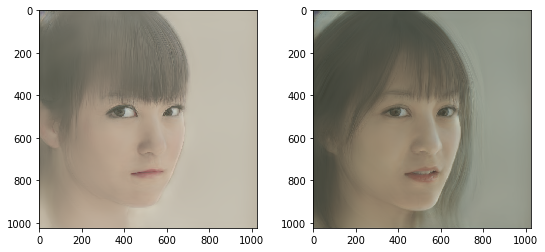

Target W+ output
W+ loss:  3265.015625


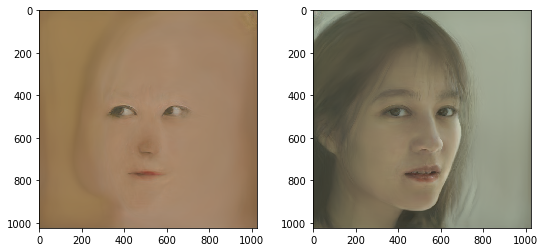

Epoch:  100
Batch:  2
This batch:  ['haruna_01', 'ayane_01']
Total time elapsed:  224.13795495033264  s
Feature loss:  55.4849853515625  | Pixel loss:  0.028336644172668457  | Target prop loss:  0.04781992733478546
Weighted - Feature loss:  5548.49853515625  | Pixel loss:  2.8336644172668457  | Target prop loss:  478.1992733478546
Total loss:  6029.53125


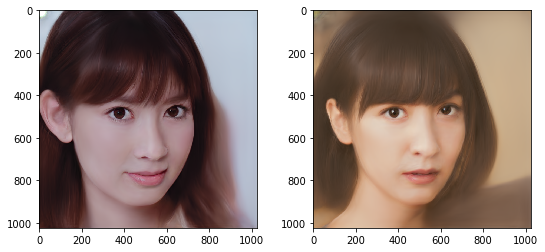

Target W+ output
W+ loss:  6481.5302734375


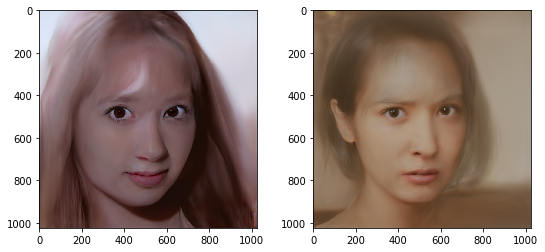

Epoch:  100
Batch:  3
This batch:  ['mariko_01', 'maeda_01']
Total time elapsed:  225.49160027503967  s
Feature loss:  35.536582946777344  | Pixel loss:  0.021460579708218575  | Target prop loss:  0.03899376839399338
Weighted - Feature loss:  3553.6582946777344  | Pixel loss:  2.1460579708218575  | Target prop loss:  389.9376839399338
Total loss:  3945.741943359375


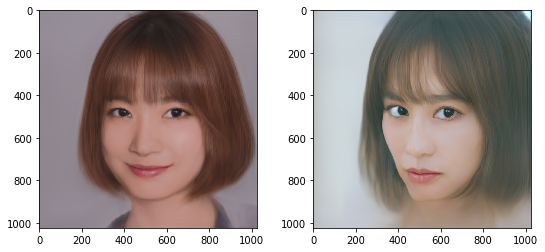

Target W+ output
W+ loss:  2989.575927734375


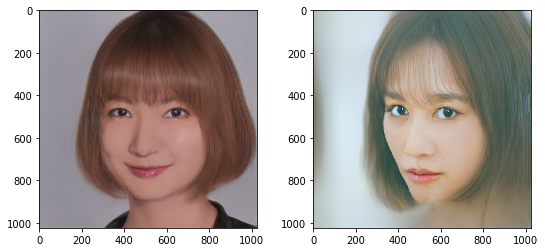

Epoch:  100
Batch:  4
This batch:  ['shiraishi_01', 'nanami_01']
Total time elapsed:  226.835120677948  s
Feature loss:  42.03384780883789  | Pixel loss:  0.020189030095934868  | Target prop loss:  0.04315530136227608
Weighted - Feature loss:  4203.384780883789  | Pixel loss:  2.018903009593487  | Target prop loss:  431.5530136227608
Total loss:  4636.95703125


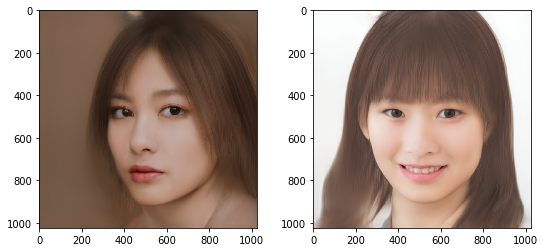

Target W+ output
W+ loss:  3654.756103515625


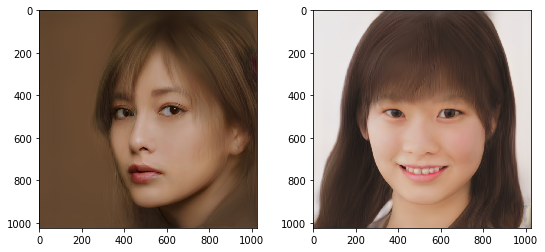

Cycle:  1 LR:  0.01
Epoch:  1
Batch:  1
This batch:  ['erika_01', 'suzuka_01']
Total time elapsed:  0.27835702896118164  s
Feature loss:  30.670360565185547  | Pixel loss:  0.035204458981752396  | Target prop loss:  0.0
Weighted - Feature loss:  3067.0360565185547  | Pixel loss:  3.5204458981752396  | Target prop loss:  0.0
Total loss:  3070.556640625


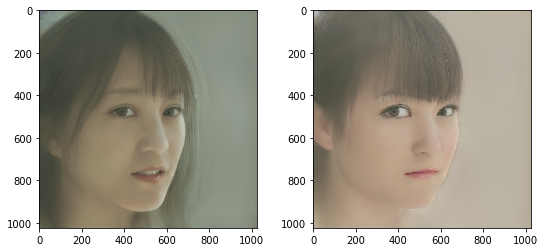

Epoch:  1
Batch:  2
This batch:  ['maeda_01', 'shiraishi_01']
Total time elapsed:  0.8376555442810059  s
Feature loss:  41.91667556762695  | Pixel loss:  0.02139420621097088  | Target prop loss:  0.0
Weighted - Feature loss:  4191.667556762695  | Pixel loss:  2.139420621097088  | Target prop loss:  0.0
Total loss:  4193.80712890625


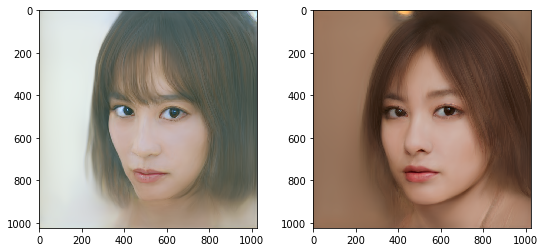

Epoch:  1
Batch:  3
This batch:  ['nanami_01', 'mariko_01']
Total time elapsed:  1.40706205368042  s
Feature loss:  42.09159469604492  | Pixel loss:  0.024369627237319946  | Target prop loss:  0.0
Weighted - Feature loss:  4209.159469604492  | Pixel loss:  2.4369627237319946  | Target prop loss:  0.0
Total loss:  4211.5966796875


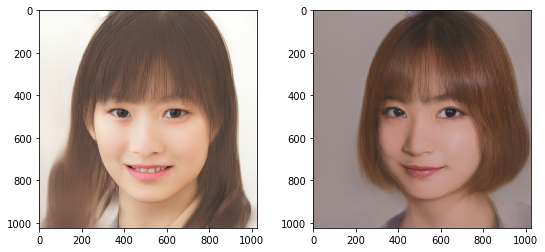

Epoch:  1
Batch:  4
This batch:  ['ayane_01', 'haruna_01']
Total time elapsed:  2.0023140907287598  s
Feature loss:  67.1525650024414  | Pixel loss:  0.03562290966510773  | Target prop loss:  0.0
Weighted - Feature loss:  6715.256500244141  | Pixel loss:  3.5622909665107727  | Target prop loss:  0.0
Total loss:  6718.81884765625


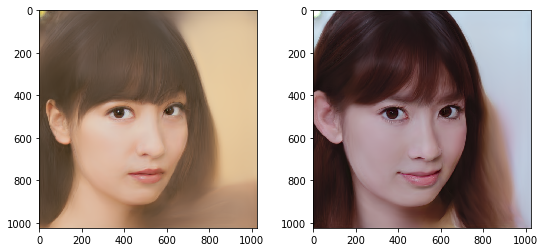

Epoch:  25
Batch:  1
This batch:  ['suzuka_01', 'erika_01']
Total time elapsed:  27.050572156906128  s
Feature loss:  29.523311614990234  | Pixel loss:  0.02211684174835682  | Target prop loss:  0.0
Weighted - Feature loss:  2952.3311614990234  | Pixel loss:  2.211684174835682  | Target prop loss:  0.0
Total loss:  2954.542724609375


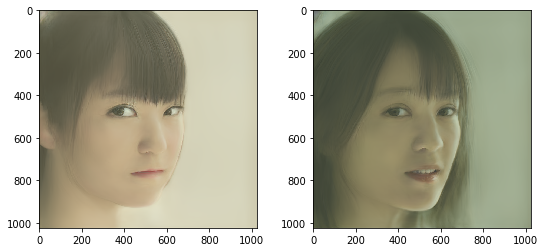

Epoch:  25
Batch:  2
This batch:  ['mariko_01', 'ayane_01']
Total time elapsed:  27.67063045501709  s
Feature loss:  39.159080505371094  | Pixel loss:  0.025497019290924072  | Target prop loss:  0.0
Weighted - Feature loss:  3915.9080505371094  | Pixel loss:  2.5497019290924072  | Target prop loss:  0.0
Total loss:  3918.457763671875


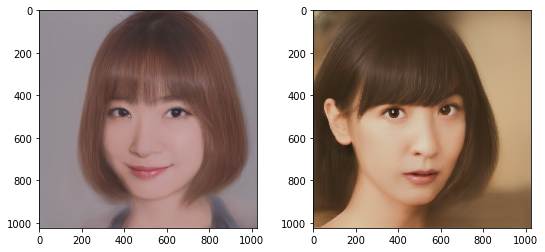

Epoch:  25
Batch:  3
This batch:  ['nanami_01', 'shiraishi_01']
Total time elapsed:  28.24111247062683  s
Feature loss:  40.7464485168457  | Pixel loss:  0.014598727226257324  | Target prop loss:  0.0
Weighted - Feature loss:  4074.6448516845703  | Pixel loss:  1.4598727226257324  | Target prop loss:  0.0
Total loss:  4076.104736328125


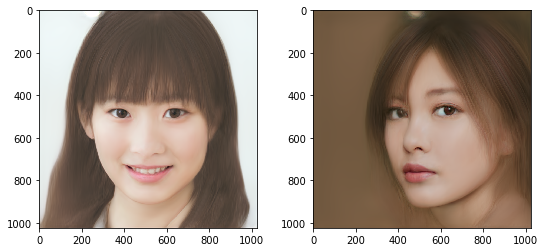

Epoch:  25
Batch:  4
This batch:  ['maeda_01', 'haruna_01']
Total time elapsed:  28.802950382232666  s
Feature loss:  48.21628189086914  | Pixel loss:  0.015700025483965874  | Target prop loss:  0.0
Weighted - Feature loss:  4821.628189086914  | Pixel loss:  1.5700025483965874  | Target prop loss:  0.0
Total loss:  4823.1982421875


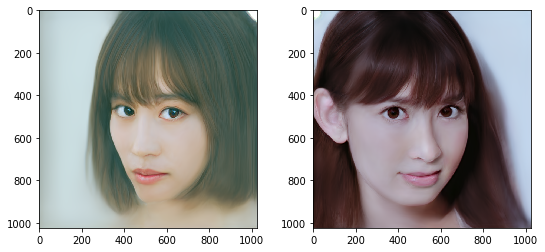

Epoch:  50
Batch:  1
This batch:  ['suzuka_01', 'erika_01']
Total time elapsed:  54.144930601119995  s
Feature loss:  27.57716941833496  | Pixel loss:  0.015695543959736824  | Target prop loss:  0.0
Weighted - Feature loss:  2757.716941833496  | Pixel loss:  1.5695543959736824  | Target prop loss:  0.0
Total loss:  2759.28662109375


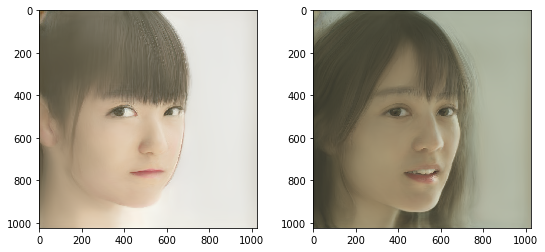

Epoch:  50
Batch:  2
This batch:  ['nanami_01', 'haruna_01']
Total time elapsed:  54.73096323013306  s
Feature loss:  49.86510467529297  | Pixel loss:  0.017384866252541542  | Target prop loss:  0.0
Weighted - Feature loss:  4986.510467529297  | Pixel loss:  1.7384866252541542  | Target prop loss:  0.0
Total loss:  4988.24853515625


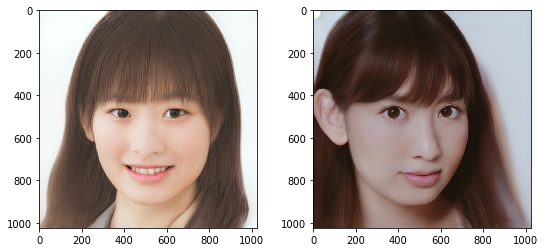

Epoch:  50
Batch:  3
This batch:  ['ayane_01', 'maeda_01']
Total time elapsed:  55.30145740509033  s
Feature loss:  45.95768356323242  | Pixel loss:  0.026792848482728004  | Target prop loss:  0.0
Weighted - Feature loss:  4595.768356323242  | Pixel loss:  2.6792848482728004  | Target prop loss:  0.0
Total loss:  4598.44775390625


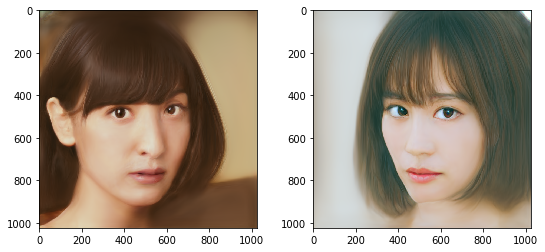

Epoch:  50
Batch:  4
This batch:  ['mariko_01', 'shiraishi_01']
Total time elapsed:  55.87241816520691  s
Feature loss:  33.60942077636719  | Pixel loss:  0.015614830888807774  | Target prop loss:  0.0
Weighted - Feature loss:  3360.9420776367188  | Pixel loss:  1.5614830888807774  | Target prop loss:  0.0
Total loss:  3362.503662109375


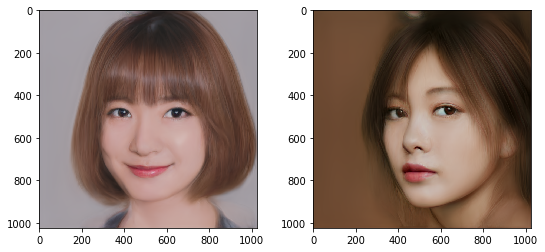

Epoch:  75
Batch:  1
This batch:  ['shiraishi_01', 'nanami_01']
Total time elapsed:  81.79929709434509  s
Feature loss:  33.76493453979492  | Pixel loss:  0.011792183853685856  | Target prop loss:  0.0
Weighted - Feature loss:  3376.493453979492  | Pixel loss:  1.1792183853685856  | Target prop loss:  0.0
Total loss:  3377.672607421875


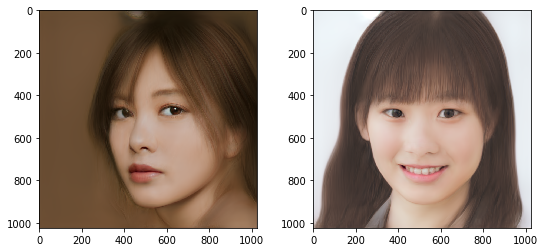

Epoch:  75
Batch:  2
This batch:  ['erika_01', 'maeda_01']
Total time elapsed:  82.39430904388428  s
Feature loss:  29.643741607666016  | Pixel loss:  0.01369559857994318  | Target prop loss:  0.0
Weighted - Feature loss:  2964.3741607666016  | Pixel loss:  1.369559857994318  | Target prop loss:  0.0
Total loss:  2965.743896484375


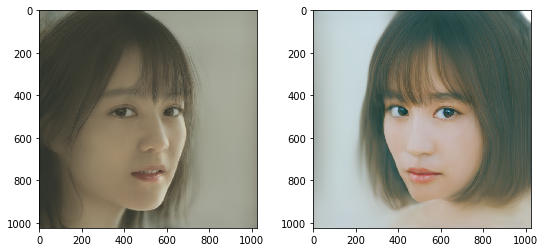

Epoch:  75
Batch:  3
This batch:  ['suzuka_01', 'mariko_01']
Total time elapsed:  82.97145938873291  s
Feature loss:  26.89664077758789  | Pixel loss:  0.014546445570886135  | Target prop loss:  0.0
Weighted - Feature loss:  2689.664077758789  | Pixel loss:  1.4546445570886135  | Target prop loss:  0.0
Total loss:  2691.11865234375


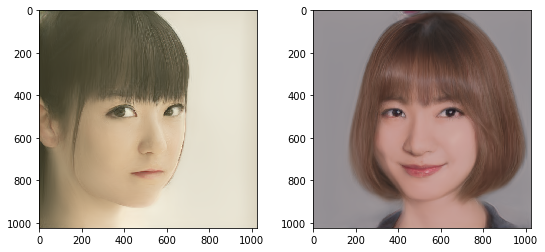

Epoch:  75
Batch:  4
This batch:  ['haruna_01', 'ayane_01']
Total time elapsed:  83.59456849098206  s
Feature loss:  49.27659606933594  | Pixel loss:  0.025756629183888435  | Target prop loss:  0.0
Weighted - Feature loss:  4927.659606933594  | Pixel loss:  2.5756629183888435  | Target prop loss:  0.0
Total loss:  4930.2353515625


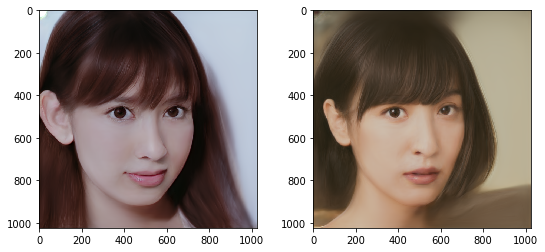

Epoch:  100
Batch:  1
This batch:  ['maeda_01', 'mariko_01']
Total time elapsed:  109.30790162086487  s
Feature loss:  30.087053298950195  | Pixel loss:  0.01363719254732132  | Target prop loss:  0.0
Weighted - Feature loss:  3008.7053298950195  | Pixel loss:  1.363719254732132  | Target prop loss:  0.0
Total loss:  3010.069091796875


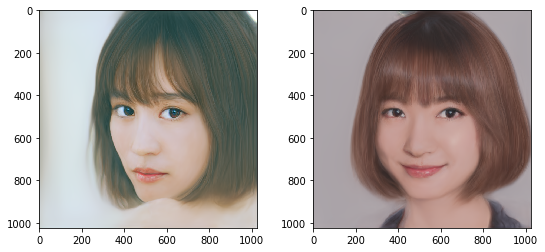

Epoch:  100
Batch:  2
This batch:  ['shiraishi_01', 'erika_01']
Total time elapsed:  109.95058965682983  s
Feature loss:  27.64967155456543  | Pixel loss:  0.01397921983152628  | Target prop loss:  0.0
Weighted - Feature loss:  2764.967155456543  | Pixel loss:  1.397921983152628  | Target prop loss:  0.0
Total loss:  2766.364990234375


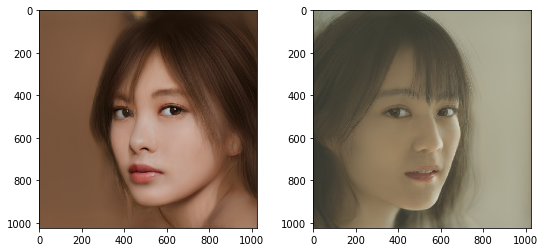

Epoch:  100
Batch:  3
This batch:  ['haruna_01', 'nanami_01']
Total time elapsed:  110.51709198951721  s
Feature loss:  43.62411880493164  | Pixel loss:  0.011698798276484013  | Target prop loss:  0.0
Weighted - Feature loss:  4362.411880493164  | Pixel loss:  1.1698798276484013  | Target prop loss:  0.0
Total loss:  4363.58203125


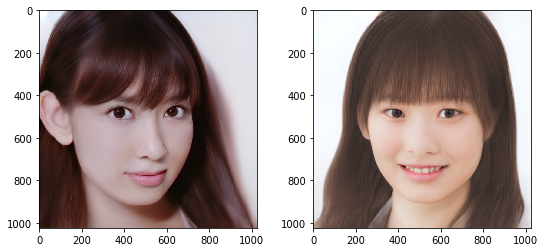

Epoch:  100
Batch:  4
This batch:  ['suzuka_01', 'ayane_01']
Total time elapsed:  111.11743569374084  s
Feature loss:  32.87186050415039  | Pixel loss:  0.018772322684526443  | Target prop loss:  0.0
Weighted - Feature loss:  3287.186050415039  | Pixel loss:  1.8772322684526443  | Target prop loss:  0.0
Total loss:  3289.063232421875


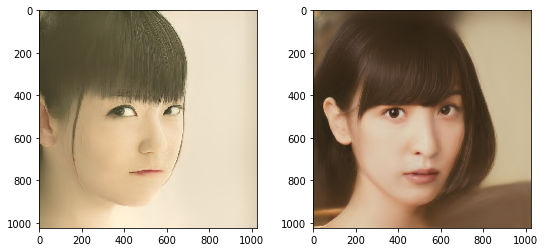

Epoch:  125
Batch:  1
This batch:  ['maeda_01', 'shiraishi_01']
Total time elapsed:  137.4307577610016  s
Feature loss:  30.66857147216797  | Pixel loss:  0.011929753236472607  | Target prop loss:  0.0
Weighted - Feature loss:  3066.857147216797  | Pixel loss:  1.1929753236472607  | Target prop loss:  0.0
Total loss:  3068.050048828125


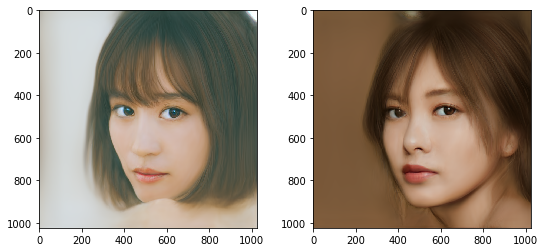

Epoch:  125
Batch:  2
This batch:  ['mariko_01', 'nanami_01']
Total time elapsed:  138.00588512420654  s
Feature loss:  27.862714767456055  | Pixel loss:  0.01087560411542654  | Target prop loss:  0.0
Weighted - Feature loss:  2786.2714767456055  | Pixel loss:  1.087560411542654  | Target prop loss:  0.0
Total loss:  2787.359130859375


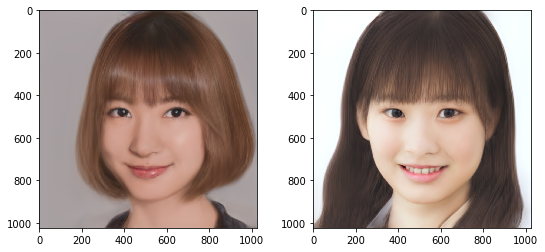

Epoch:  125
Batch:  3
This batch:  ['erika_01', 'suzuka_01']
Total time elapsed:  138.58440685272217  s
Feature loss:  22.956022262573242  | Pixel loss:  0.009676571935415268  | Target prop loss:  0.0
Weighted - Feature loss:  2295.602226257324  | Pixel loss:  0.9676571935415268  | Target prop loss:  0.0
Total loss:  2296.570068359375


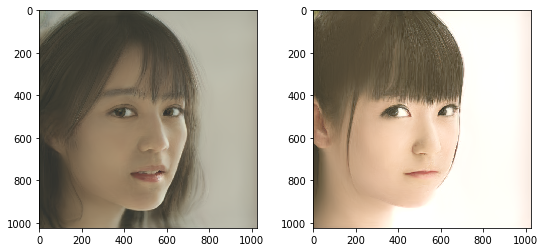

Epoch:  125
Batch:  4
This batch:  ['haruna_01', 'ayane_01']
Total time elapsed:  139.22108554840088  s
Feature loss:  43.12531661987305  | Pixel loss:  0.014375693164765835  | Target prop loss:  0.0
Weighted - Feature loss:  4312.531661987305  | Pixel loss:  1.4375693164765835  | Target prop loss:  0.0
Total loss:  4313.96923828125


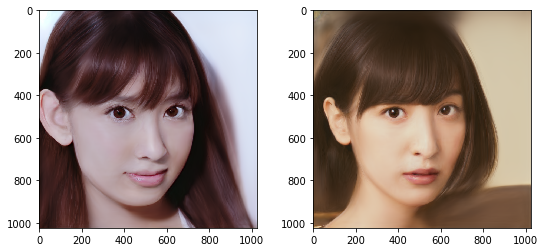

Epoch:  150
Batch:  1
This batch:  ['suzuka_01', 'erika_01']
Total time elapsed:  165.9027283191681  s
Feature loss:  21.334522247314453  | Pixel loss:  0.008890276774764061  | Target prop loss:  0.0
Weighted - Feature loss:  2133.4522247314453  | Pixel loss:  0.8890276774764061  | Target prop loss:  0.0
Total loss:  2134.341064453125


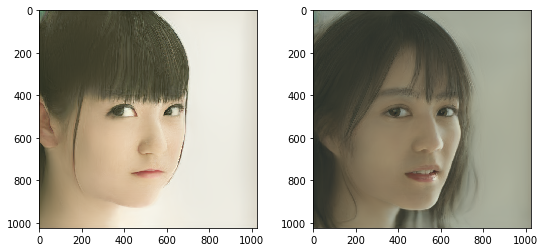

Epoch:  150
Batch:  2
This batch:  ['nanami_01', 'shiraishi_01']
Total time elapsed:  166.4656970500946  s
Feature loss:  29.14322280883789  | Pixel loss:  0.008735066279768944  | Target prop loss:  0.0
Weighted - Feature loss:  2914.322280883789  | Pixel loss:  0.8735066279768944  | Target prop loss:  0.0
Total loss:  2915.19580078125


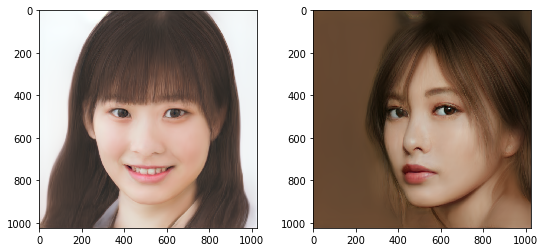

Epoch:  150
Batch:  3
This batch:  ['maeda_01', 'mariko_01']
Total time elapsed:  167.03368282318115  s
Feature loss:  28.896862030029297  | Pixel loss:  0.015369240194559097  | Target prop loss:  0.0
Weighted - Feature loss:  2889.6862030029297  | Pixel loss:  1.5369240194559097  | Target prop loss:  0.0
Total loss:  2891.22314453125


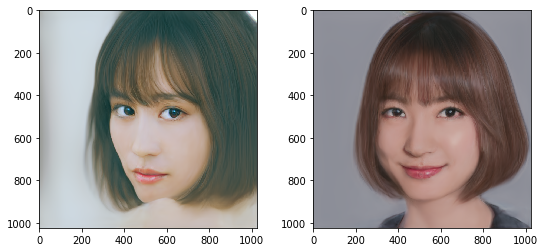

Epoch:  150
Batch:  4
This batch:  ['haruna_01', 'ayane_01']
Total time elapsed:  167.600652217865  s
Feature loss:  42.04996871948242  | Pixel loss:  0.017798779532313347  | Target prop loss:  0.0
Weighted - Feature loss:  4204.996871948242  | Pixel loss:  1.7798779532313347  | Target prop loss:  0.0
Total loss:  4206.77685546875


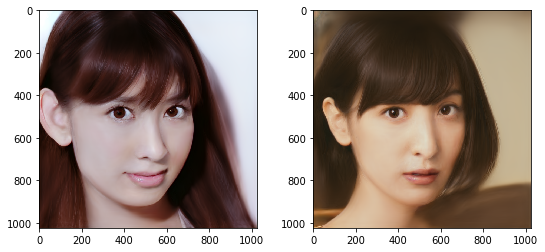

Epoch:  175
Batch:  1
This batch:  ['nanami_01', 'suzuka_01']
Total time elapsed:  193.770446062088  s
Feature loss:  25.199260711669922  | Pixel loss:  0.0070417835377156734  | Target prop loss:  0.0
Weighted - Feature loss:  2519.926071166992  | Pixel loss:  0.7041783537715673  | Target prop loss:  0.0
Total loss:  2520.630126953125


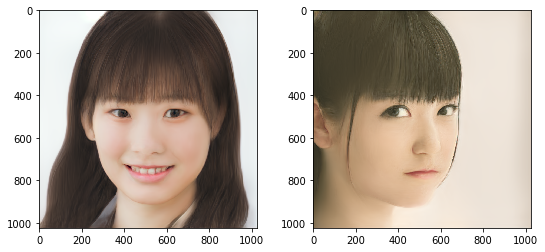

Epoch:  175
Batch:  2
This batch:  ['haruna_01', 'maeda_01']
Total time elapsed:  194.39467406272888  s
Feature loss:  37.18421936035156  | Pixel loss:  0.008478992618620396  | Target prop loss:  0.0
Weighted - Feature loss:  3718.4219360351562  | Pixel loss:  0.8478992618620396  | Target prop loss:  0.0
Total loss:  3719.269775390625


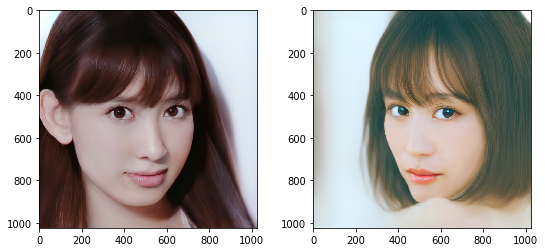

Epoch:  175
Batch:  3
This batch:  ['erika_01', 'shiraishi_01']
Total time elapsed:  194.96712136268616  s
Feature loss:  25.51093864440918  | Pixel loss:  0.010930554009974003  | Target prop loss:  0.0
Weighted - Feature loss:  2551.093864440918  | Pixel loss:  1.0930554009974003  | Target prop loss:  0.0
Total loss:  2552.186767578125


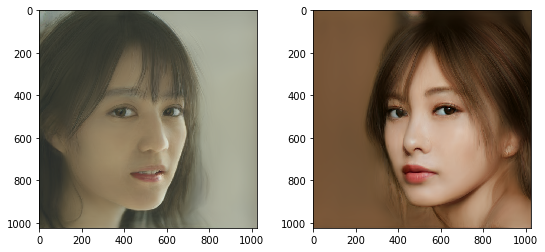

Epoch:  175
Batch:  4
This batch:  ['mariko_01', 'ayane_01']
Total time elapsed:  195.53240370750427  s
Feature loss:  33.15636444091797  | Pixel loss:  0.01848764531314373  | Target prop loss:  0.0
Weighted - Feature loss:  3315.636444091797  | Pixel loss:  1.848764531314373  | Target prop loss:  0.0
Total loss:  3317.4853515625


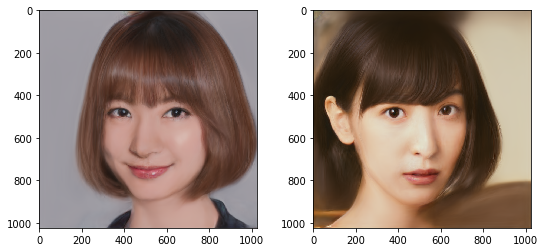

Epoch:  200
Batch:  1
This batch:  ['maeda_01', 'suzuka_01']
Total time elapsed:  220.89348912239075  s
Feature loss:  26.21271514892578  | Pixel loss:  0.014509405009448528  | Target prop loss:  0.0
Weighted - Feature loss:  2621.271514892578  | Pixel loss:  1.4509405009448528  | Target prop loss:  0.0
Total loss:  2622.722412109375


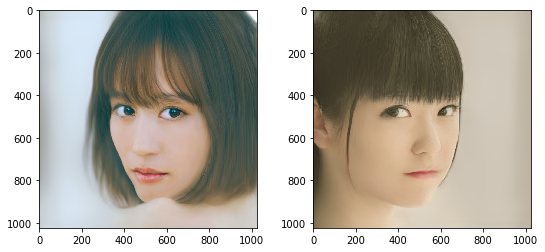

Epoch:  200
Batch:  2
This batch:  ['ayane_01', 'erika_01']
Total time elapsed:  221.47140264511108  s
Feature loss:  29.540390014648438  | Pixel loss:  0.01953325979411602  | Target prop loss:  0.0
Weighted - Feature loss:  2954.0390014648438  | Pixel loss:  1.953325979411602  | Target prop loss:  0.0
Total loss:  2955.992431640625


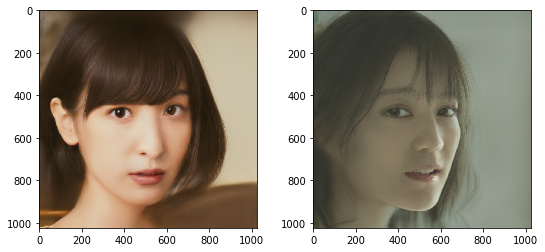

Epoch:  200
Batch:  3
This batch:  ['haruna_01', 'nanami_01']
Total time elapsed:  222.0368049144745  s
Feature loss:  38.48825454711914  | Pixel loss:  0.008906769566237926  | Target prop loss:  0.0
Weighted - Feature loss:  3848.825454711914  | Pixel loss:  0.8906769566237926  | Target prop loss:  0.0
Total loss:  3849.716064453125


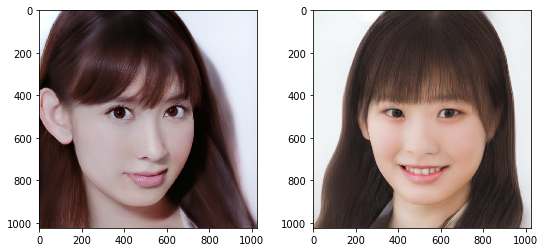

Epoch:  200
Batch:  4
This batch:  ['mariko_01', 'shiraishi_01']
Total time elapsed:  222.62172627449036  s
Feature loss:  24.50387954711914  | Pixel loss:  0.013979756273329258  | Target prop loss:  0.0
Weighted - Feature loss:  2450.387954711914  | Pixel loss:  1.3979756273329258  | Target prop loss:  0.0
Total loss:  2451.785888671875


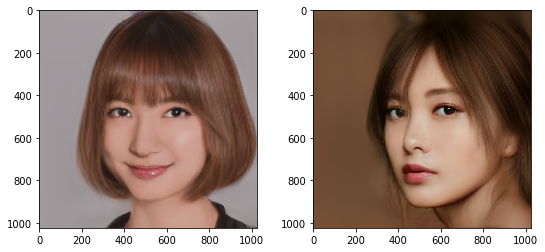

Cycle:  2 LR:  0.001
Epoch:  1
Batch:  1
This batch:  ['mariko_01', 'haruna_01']
Total time elapsed:  0.2723970413208008  s
Feature loss:  31.496492385864258  | Pixel loss:  0.01235282514244318  | Target prop loss:  0.0
Weighted - Feature loss:  3149.649238586426  | Pixel loss:  1.235282514244318  | Target prop loss:  0.0
Total loss:  3150.884521484375


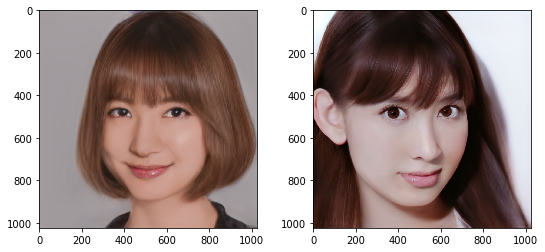

Epoch:  1
Batch:  2
This batch:  ['nanami_01', 'suzuka_01']
Total time elapsed:  0.8357043266296387  s
Feature loss:  24.412010192871094  | Pixel loss:  0.008708341978490353  | Target prop loss:  0.0
Weighted - Feature loss:  2441.2010192871094  | Pixel loss:  0.8708341978490353  | Target prop loss:  0.0
Total loss:  2442.07177734375


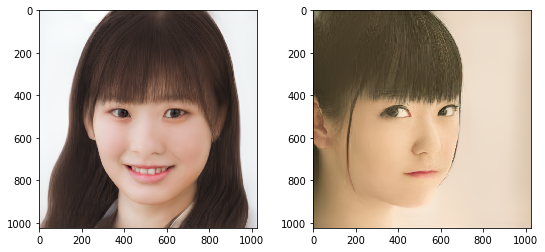

Epoch:  1
Batch:  3
This batch:  ['erika_01', 'maeda_01']
Total time elapsed:  1.395068645477295  s
Feature loss:  25.567468643188477  | Pixel loss:  0.009956502355635166  | Target prop loss:  0.0
Weighted - Feature loss:  2556.7468643188477  | Pixel loss:  0.9956502355635166  | Target prop loss:  0.0
Total loss:  2557.742431640625


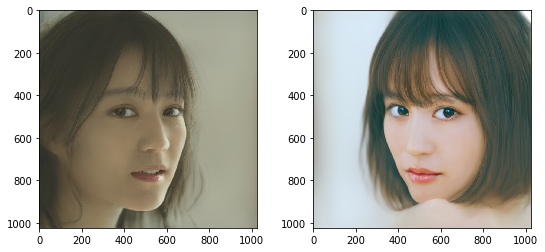

Epoch:  1
Batch:  4
This batch:  ['shiraishi_01', 'ayane_01']
Total time elapsed:  1.9563179016113281  s
Feature loss:  29.77731704711914  | Pixel loss:  0.014400884509086609  | Target prop loss:  0.0
Weighted - Feature loss:  2977.731704711914  | Pixel loss:  1.4400884509086609  | Target prop loss:  0.0
Total loss:  2979.171875


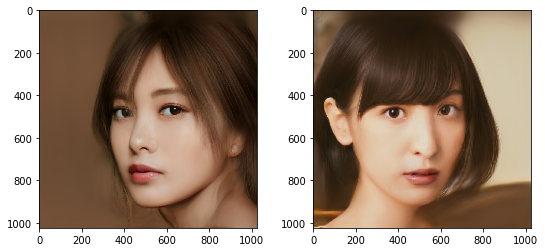

Epoch:  25
Batch:  1
This batch:  ['ayane_01', 'mariko_01']
Total time elapsed:  26.788133144378662  s
Feature loss:  23.97182273864746  | Pixel loss:  0.01337004080414772  | Target prop loss:  0.0
Weighted - Feature loss:  2397.182273864746  | Pixel loss:  1.337004080414772  | Target prop loss:  0.0
Total loss:  2398.519287109375


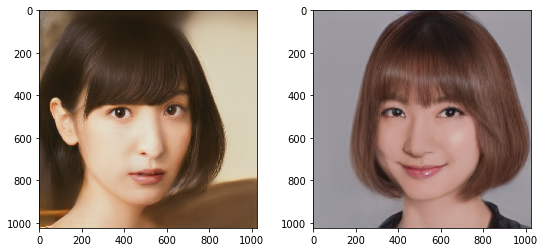

Epoch:  25
Batch:  2
This batch:  ['shiraishi_01', 'suzuka_01']
Total time elapsed:  27.416146516799927  s
Feature loss:  19.776752471923828  | Pixel loss:  0.00711580365896225  | Target prop loss:  0.0
Weighted - Feature loss:  1977.6752471923828  | Pixel loss:  0.711580365896225  | Target prop loss:  0.0
Total loss:  1978.3868408203125


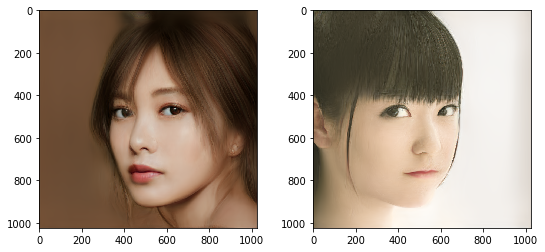

Epoch:  25
Batch:  3
This batch:  ['haruna_01', 'nanami_01']
Total time elapsed:  28.000171184539795  s
Feature loss:  29.690214157104492  | Pixel loss:  0.007269252557307482  | Target prop loss:  0.0
Weighted - Feature loss:  2969.021415710449  | Pixel loss:  0.7269252557307482  | Target prop loss:  0.0
Total loss:  2969.748291015625


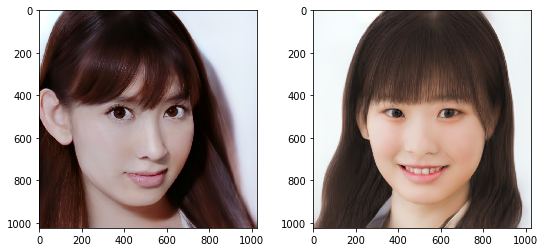

Epoch:  25
Batch:  4
This batch:  ['erika_01', 'maeda_01']
Total time elapsed:  28.579233407974243  s
Feature loss:  21.352436065673828  | Pixel loss:  0.007257029414176941  | Target prop loss:  0.0
Weighted - Feature loss:  2135.243606567383  | Pixel loss:  0.7257029414176941  | Target prop loss:  0.0
Total loss:  2135.96923828125


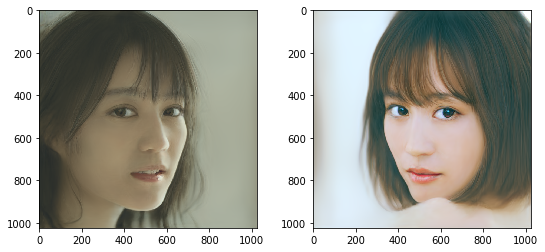

Epoch:  50
Batch:  1
This batch:  ['ayane_01', 'shiraishi_01']
Total time elapsed:  54.511528968811035  s
Feature loss:  25.45096778869629  | Pixel loss:  0.009823660366237164  | Target prop loss:  0.0
Weighted - Feature loss:  2545.096778869629  | Pixel loss:  0.9823660366237164  | Target prop loss:  0.0
Total loss:  2546.0791015625


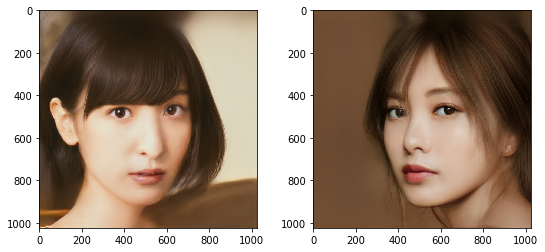

Epoch:  50
Batch:  2
This batch:  ['maeda_01', 'nanami_01']
Total time elapsed:  55.0872278213501  s
Feature loss:  22.051109313964844  | Pixel loss:  0.004571869503706694  | Target prop loss:  0.0
Weighted - Feature loss:  2205.1109313964844  | Pixel loss:  0.45718695037066936  | Target prop loss:  0.0
Total loss:  2205.568115234375


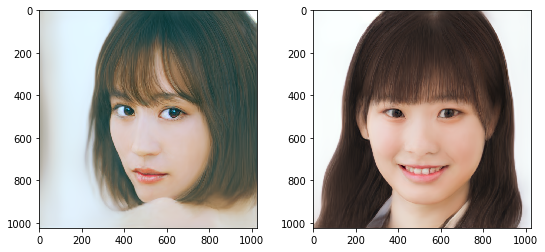

Epoch:  50
Batch:  3
This batch:  ['haruna_01', 'mariko_01']
Total time elapsed:  55.65306043624878  s
Feature loss:  26.88216209411621  | Pixel loss:  0.01180845033377409  | Target prop loss:  0.0
Weighted - Feature loss:  2688.216209411621  | Pixel loss:  1.180845033377409  | Target prop loss:  0.0
Total loss:  2689.397216796875


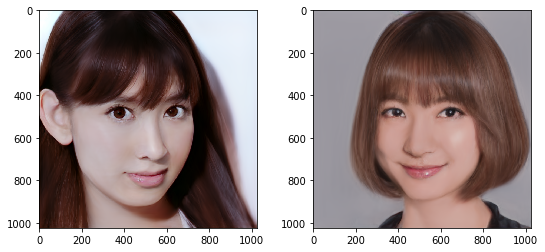

Epoch:  50
Batch:  4
This batch:  ['suzuka_01', 'erika_01']
Total time elapsed:  56.23525261878967  s
Feature loss:  17.164260864257812  | Pixel loss:  0.007333750370889902  | Target prop loss:  0.0
Weighted - Feature loss:  1716.4260864257812  | Pixel loss:  0.7333750370889902  | Target prop loss:  0.0
Total loss:  1717.159423828125


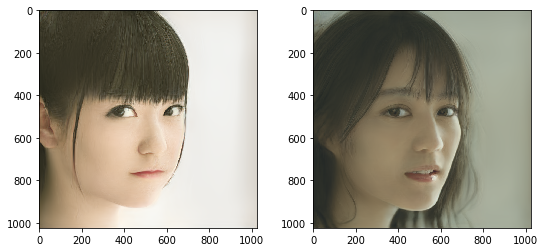

Epoch:  75
Batch:  1
This batch:  ['mariko_01', 'maeda_01']
Total time elapsed:  82.26918435096741  s
Feature loss:  19.700735092163086  | Pixel loss:  0.0092774024233222  | Target prop loss:  0.0
Weighted - Feature loss:  1970.0735092163086  | Pixel loss:  0.9277402423322201  | Target prop loss:  0.0
Total loss:  1971.001220703125


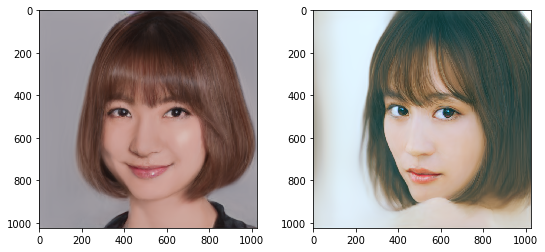

Epoch:  75
Batch:  2
This batch:  ['erika_01', 'haruna_01']
Total time elapsed:  82.89379835128784  s
Feature loss:  26.630781173706055  | Pixel loss:  0.010027080774307251  | Target prop loss:  0.0
Weighted - Feature loss:  2663.0781173706055  | Pixel loss:  1.002708077430725  | Target prop loss:  0.0
Total loss:  2664.080810546875


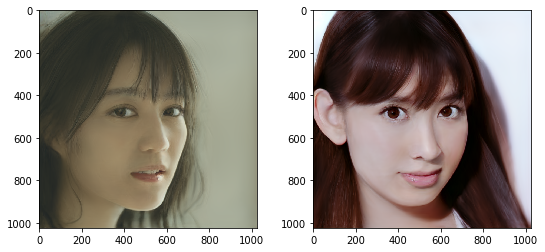

Epoch:  75
Batch:  3
This batch:  ['ayane_01', 'suzuka_01']
Total time elapsed:  83.46348071098328  s
Feature loss:  22.62500762939453  | Pixel loss:  0.00808607880026102  | Target prop loss:  0.0
Weighted - Feature loss:  2262.500762939453  | Pixel loss:  0.8086078800261021  | Target prop loss:  0.0
Total loss:  2263.309326171875


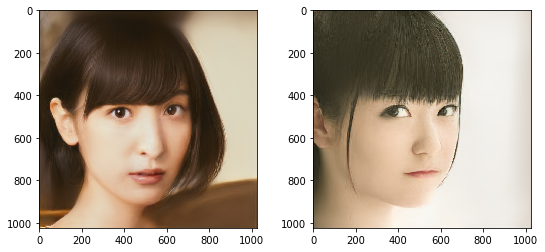

Epoch:  75
Batch:  4
This batch:  ['nanami_01', 'shiraishi_01']
Total time elapsed:  84.02831768989563  s
Feature loss:  22.008501052856445  | Pixel loss:  0.006268702447414398  | Target prop loss:  0.0
Weighted - Feature loss:  2200.8501052856445  | Pixel loss:  0.6268702447414398  | Target prop loss:  0.0
Total loss:  2201.47705078125


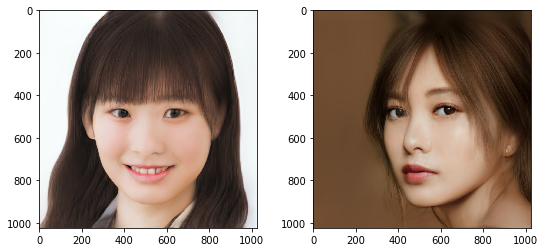

Epoch:  100
Batch:  1
This batch:  ['ayane_01', 'mariko_01']
Total time elapsed:  109.80956172943115  s
Feature loss:  22.727846145629883  | Pixel loss:  0.01213312242180109  | Target prop loss:  0.0
Weighted - Feature loss:  2272.7846145629883  | Pixel loss:  1.213312242180109  | Target prop loss:  0.0
Total loss:  2273.998046875


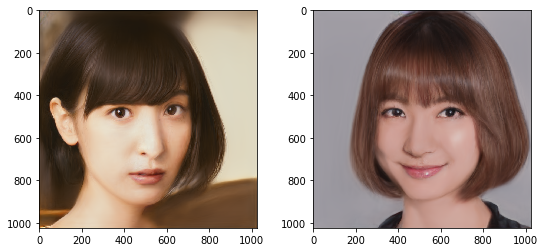

Epoch:  100
Batch:  2
This batch:  ['maeda_01', 'shiraishi_01']
Total time elapsed:  110.43980622291565  s
Feature loss:  21.409320831298828  | Pixel loss:  0.006327874958515167  | Target prop loss:  0.0
Weighted - Feature loss:  2140.932083129883  | Pixel loss:  0.6327874958515167  | Target prop loss:  0.0
Total loss:  2141.56494140625


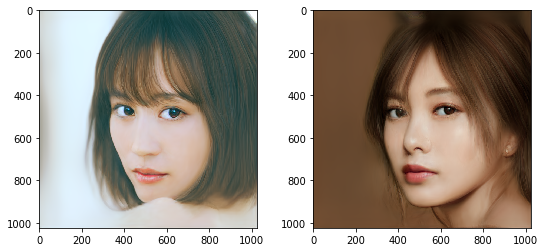

Epoch:  100
Batch:  3
This batch:  ['erika_01', 'nanami_01']
Total time elapsed:  111.00284814834595  s
Feature loss:  19.26994514465332  | Pixel loss:  0.007274487987160683  | Target prop loss:  0.0
Weighted - Feature loss:  1926.994514465332  | Pixel loss:  0.7274487987160683  | Target prop loss:  0.0
Total loss:  1927.721923828125


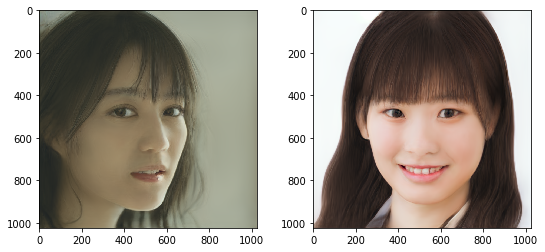

Epoch:  100
Batch:  4
This batch:  ['haruna_01', 'suzuka_01']
Total time elapsed:  111.56694722175598  s
Feature loss:  25.650808334350586  | Pixel loss:  0.0070937504060566425  | Target prop loss:  0.0
Weighted - Feature loss:  2565.0808334350586  | Pixel loss:  0.7093750406056643  | Target prop loss:  0.0
Total loss:  2565.790283203125


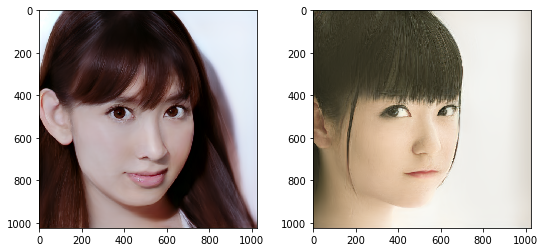

Epoch:  125
Batch:  1
This batch:  ['mariko_01', 'erika_01']
Total time elapsed:  136.97360610961914  s
Feature loss:  17.233304977416992  | Pixel loss:  0.011725082993507385  | Target prop loss:  0.0
Weighted - Feature loss:  1723.3304977416992  | Pixel loss:  1.1725082993507385  | Target prop loss:  0.0
Total loss:  1724.5029296875


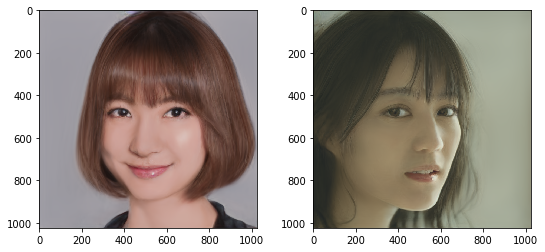

Epoch:  125
Batch:  2
This batch:  ['suzuka_01', 'ayane_01']
Total time elapsed:  137.5406677722931  s
Feature loss:  21.67367935180664  | Pixel loss:  0.007493302691727877  | Target prop loss:  0.0
Weighted - Feature loss:  2167.367935180664  | Pixel loss:  0.7493302691727877  | Target prop loss:  0.0
Total loss:  2168.1171875


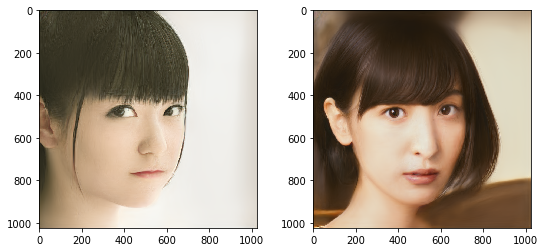

Epoch:  125
Batch:  3
This batch:  ['maeda_01', 'nanami_01']
Total time elapsed:  138.10737133026123  s
Feature loss:  21.092985153198242  | Pixel loss:  0.004642394836992025  | Target prop loss:  0.0
Weighted - Feature loss:  2109.298515319824  | Pixel loss:  0.46423948369920254  | Target prop loss:  0.0
Total loss:  2109.762939453125


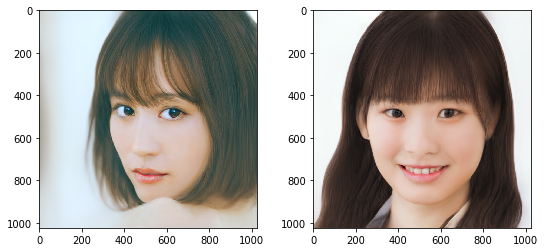

Epoch:  125
Batch:  4
This batch:  ['shiraishi_01', 'haruna_01']
Total time elapsed:  138.67916464805603  s
Feature loss:  27.758865356445312  | Pixel loss:  0.008625178597867489  | Target prop loss:  0.0
Weighted - Feature loss:  2775.8865356445312  | Pixel loss:  0.8625178597867489  | Target prop loss:  0.0
Total loss:  2776.7490234375


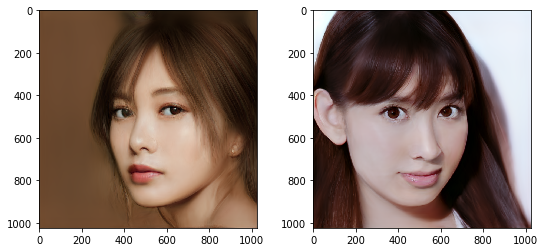

Epoch:  150
Batch:  1
This batch:  ['nanami_01', 'mariko_01']
Total time elapsed:  164.2925159931183  s
Feature loss:  18.106172561645508  | Pixel loss:  0.008567754179239273  | Target prop loss:  0.0
Weighted - Feature loss:  1810.6172561645508  | Pixel loss:  0.8567754179239273  | Target prop loss:  0.0
Total loss:  1811.47412109375


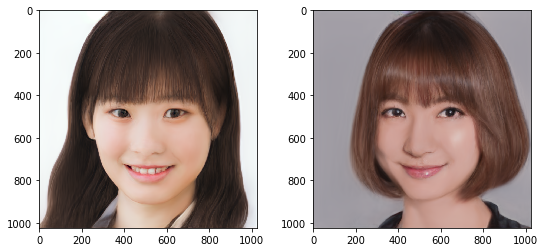

Epoch:  150
Batch:  2
This batch:  ['ayane_01', 'shiraishi_01']
Total time elapsed:  164.8612105846405  s
Feature loss:  24.173095703125  | Pixel loss:  0.008580353111028671  | Target prop loss:  0.0
Weighted - Feature loss:  2417.3095703125  | Pixel loss:  0.8580353111028671  | Target prop loss:  0.0
Total loss:  2418.167724609375


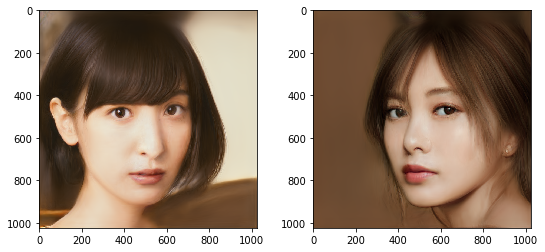

Epoch:  150
Batch:  3
This batch:  ['suzuka_01', 'maeda_01']
Total time elapsed:  165.4285089969635  s
Feature loss:  18.017288208007812  | Pixel loss:  0.004775066394358873  | Target prop loss:  0.0
Weighted - Feature loss:  1801.7288208007812  | Pixel loss:  0.47750663943588734  | Target prop loss:  0.0
Total loss:  1802.206298828125


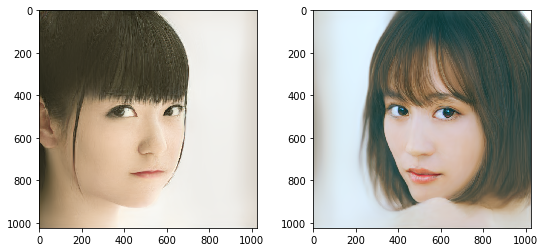

Epoch:  150
Batch:  4
This batch:  ['erika_01', 'haruna_01']
Total time elapsed:  165.9937560558319  s
Feature loss:  25.808326721191406  | Pixel loss:  0.009262974373996258  | Target prop loss:  0.0
Weighted - Feature loss:  2580.8326721191406  | Pixel loss:  0.9262974373996258  | Target prop loss:  0.0
Total loss:  2581.759033203125


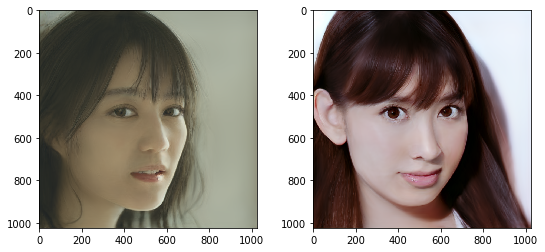

Epoch:  175
Batch:  1
This batch:  ['nanami_01', 'suzuka_01']
Total time elapsed:  191.7988965511322  s
Feature loss:  17.23035430908203  | Pixel loss:  0.004286339972168207  | Target prop loss:  0.0
Weighted - Feature loss:  1723.0354309082031  | Pixel loss:  0.4286339972168207  | Target prop loss:  0.0
Total loss:  1723.4639892578125


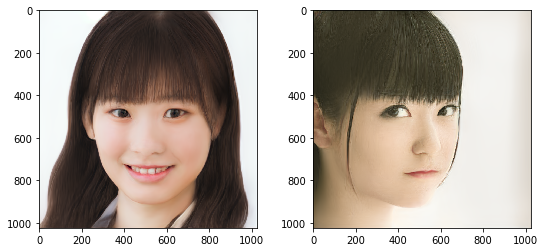

Epoch:  175
Batch:  2
This batch:  ['ayane_01', 'haruna_01']
Total time elapsed:  192.461651802063  s
Feature loss:  31.38262176513672  | Pixel loss:  0.009262890554964542  | Target prop loss:  0.0
Weighted - Feature loss:  3138.262176513672  | Pixel loss:  0.9262890554964542  | Target prop loss:  0.0
Total loss:  3139.1884765625


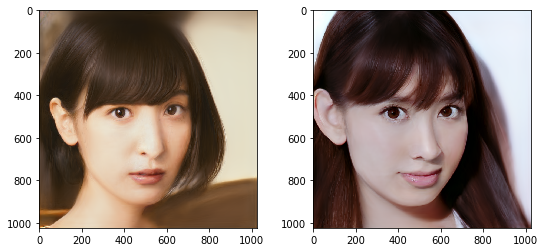

Epoch:  175
Batch:  3
This batch:  ['mariko_01', 'shiraishi_01']
Total time elapsed:  193.04306268692017  s
Feature loss:  18.314258575439453  | Pixel loss:  0.010021176189184189  | Target prop loss:  0.0
Weighted - Feature loss:  1831.4258575439453  | Pixel loss:  1.0021176189184189  | Target prop loss:  0.0
Total loss:  1832.427978515625


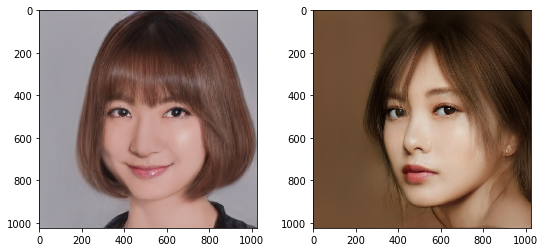

Epoch:  175
Batch:  4
This batch:  ['maeda_01', 'erika_01']
Total time elapsed:  193.61554837226868  s
Feature loss:  19.848777770996094  | Pixel loss:  0.007613506633788347  | Target prop loss:  0.0
Weighted - Feature loss:  1984.8777770996094  | Pixel loss:  0.7613506633788347  | Target prop loss:  0.0
Total loss:  1985.63916015625


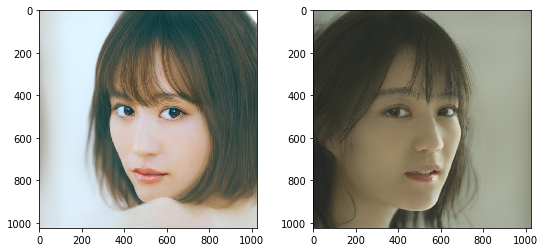

Epoch:  200
Batch:  1
This batch:  ['erika_01', 'ayane_01']
Total time elapsed:  219.47146606445312  s
Feature loss:  22.06428337097168  | Pixel loss:  0.009228459559381008  | Target prop loss:  0.0
Weighted - Feature loss:  2206.428337097168  | Pixel loss:  0.9228459559381008  | Target prop loss:  0.0
Total loss:  2207.35107421875


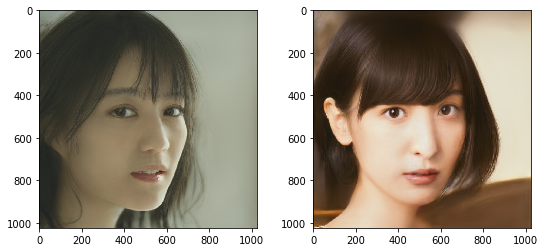

Epoch:  200
Batch:  2
This batch:  ['nanami_01', 'maeda_01']
Total time elapsed:  220.05951690673828  s
Feature loss:  21.04127311706543  | Pixel loss:  0.004542348440736532  | Target prop loss:  0.0
Weighted - Feature loss:  2104.127311706543  | Pixel loss:  0.4542348440736532  | Target prop loss:  0.0
Total loss:  2104.58154296875


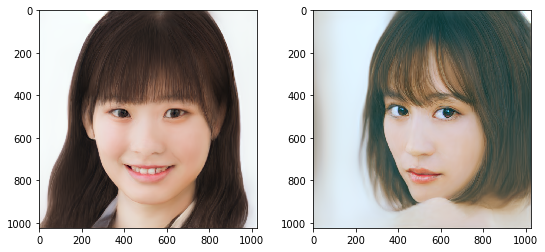

Epoch:  200
Batch:  3
This batch:  ['haruna_01', 'shiraishi_01']
Total time elapsed:  220.6236927509308  s
Feature loss:  26.798913955688477  | Pixel loss:  0.008016861043870449  | Target prop loss:  0.0
Weighted - Feature loss:  2679.8913955688477  | Pixel loss:  0.8016861043870449  | Target prop loss:  0.0
Total loss:  2680.693115234375


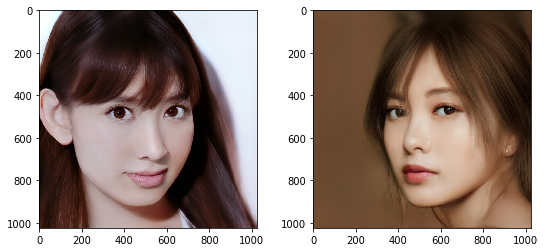

Epoch:  200
Batch:  4
This batch:  ['suzuka_01', 'mariko_01']
Total time elapsed:  221.20252561569214  s
Feature loss:  15.091392517089844  | Pixel loss:  0.008576749823987484  | Target prop loss:  0.0
Weighted - Feature loss:  1509.1392517089844  | Pixel loss:  0.8576749823987484  | Target prop loss:  0.0
Total loss:  1509.9969482421875


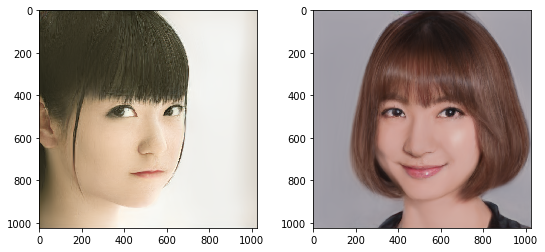

Total time elapsed for all training cycles:  675.0725209712982  s


In [4]:
TrainFaceModel(FaceModel, FaceData)

### 5. Save FaceData and FaceModel

In [5]:
DataPath = 'Idol FaceSpace/FaceData.obj'
ModelPath = 'Idol FaceSpace/FaceModel_weights.pth'
SaveFaceSpace(FaceData, DataPath, FaceModel, ModelPath)

FaceData saved to  Idol FaceSpace/FaceData.obj
FaceModel saved to  Idol FaceSpace/FaceModel_weights.pth


### 5b. Load FaceData and FaceModel from saved paths

In [6]:
DataPath = 'Idol FaceSpace/FaceData.obj'
ModelPath = 'Idol FaceSpace/FaceModel_weights.pth'
FaceData, FaceModel = LoadFaceSpace(DataPath, ModelPath, GetFeatureMaps=False)

No Zdims explicitly specified, inferring Zdims from FaceData, Zdims=8
Loading model weights from path...
Done


### 6. Show some of the faces generated by the FaceModel
#### Faces based on weighted sum of orthogonal vectors (optional random sum), interpolate between orthogonal vectors for face morphing 

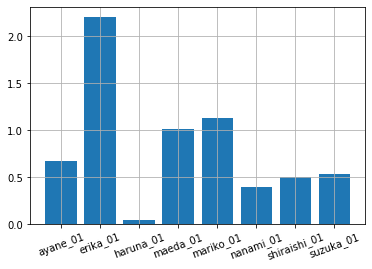

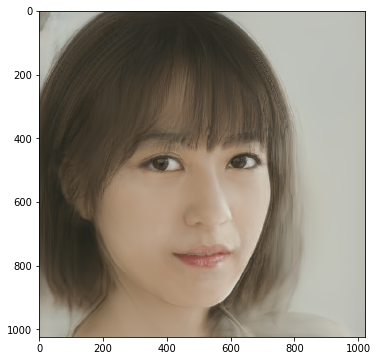

In [13]:
RandomFace = ShowFace(FaceModel, FaceData=FaceData, Random=True)

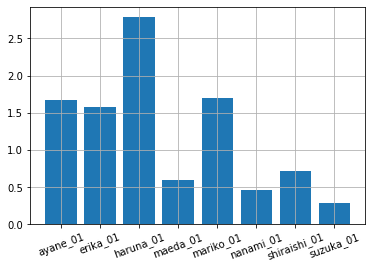

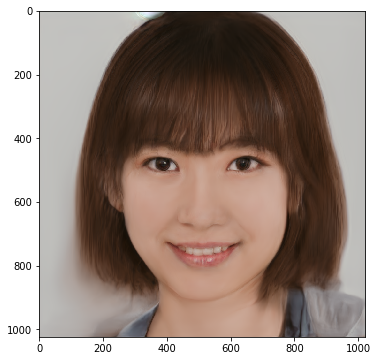

In [31]:
RandomFace = ShowFace(FaceModel, FaceData=FaceData, Random=True)

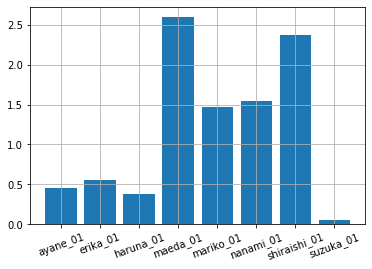

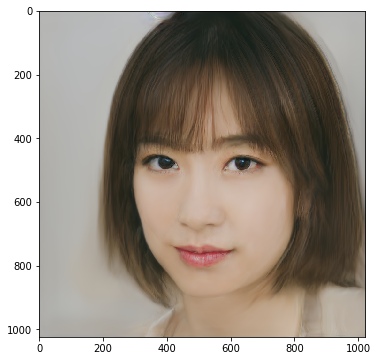

In [26]:
RandomFace = ShowFace(FaceModel, FaceData=FaceData, Random=True)

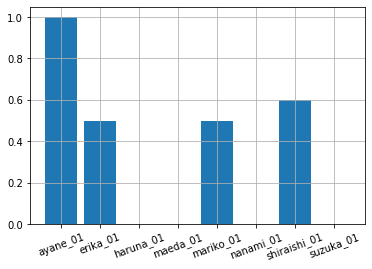

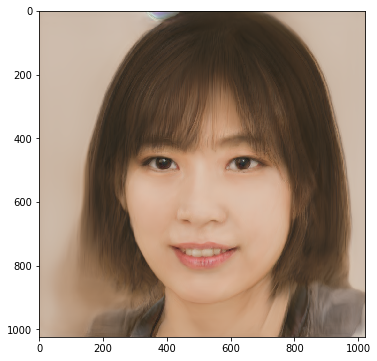

In [42]:
FaceVectors = [1,0.5,0,0,0.5,0,0.6,0]
ShowFace(FaceModel, FaceVectors=FaceVectors, FaceData=FaceData)

### Show interpolations between faces

In [ ]:
import random
from plot_utils import InterpolateCompressed

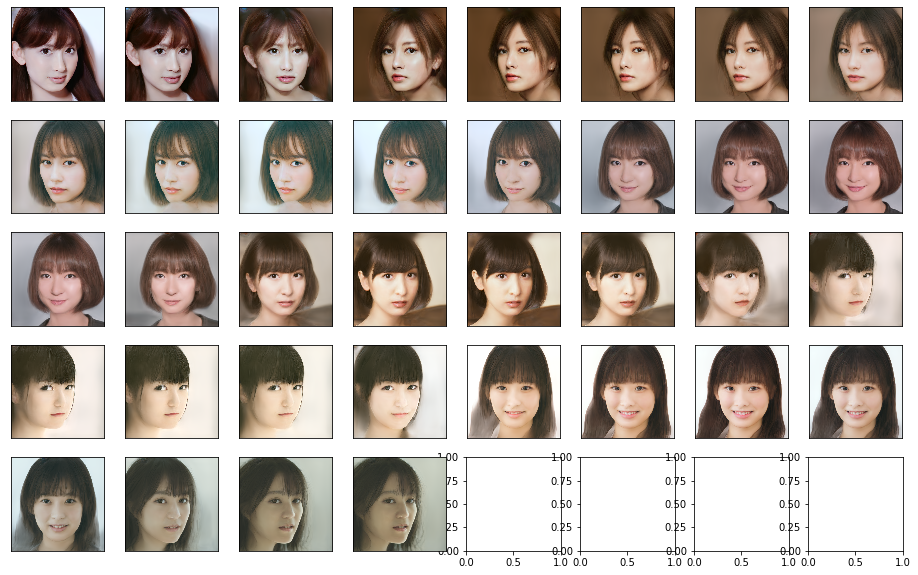

In [114]:
FixedLatents = [FixedLatent for FixedLatent in FaceData.Zspace]
random.shuffle(FixedLatents)
InterpolateCompressed(FixedLatents, FaceModel, Steps=5, ClearOutput=False, FigSize=(2,2), Tiled=True)

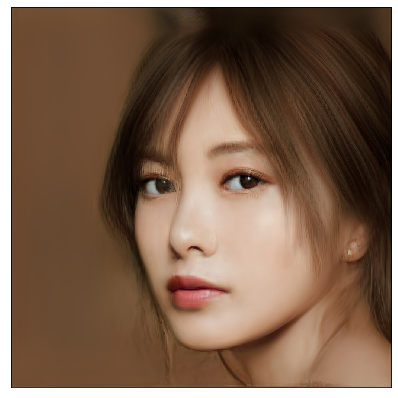

In [17]:
FixedLatents = [FixedLatent.cuda() for FixedLatent in FaceData.Zspace]
random.shuffle(FixedLatents)
InterpolateCompressed(FixedLatents, FaceModel, Steps=8, ClearOutput=True, FigSize=(7,7), Tiled=False)

### Just plot the training set

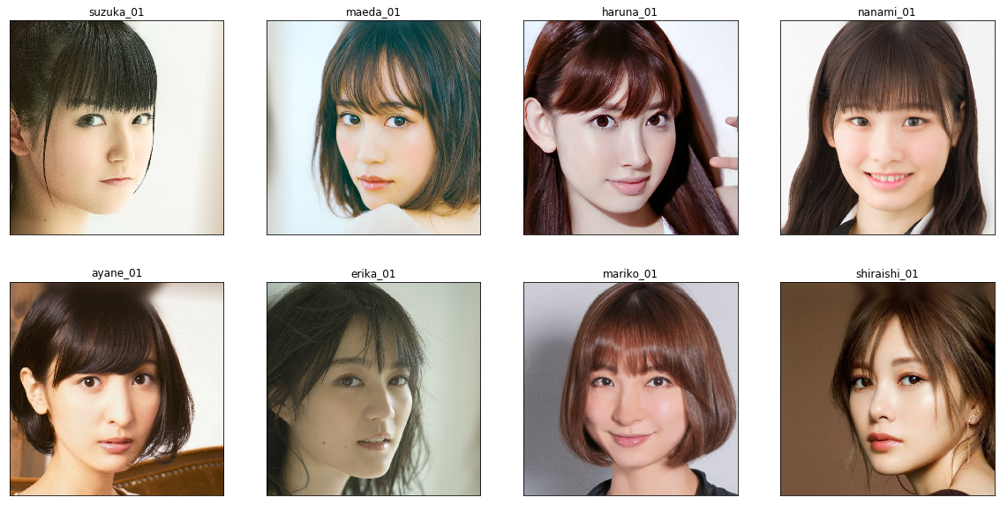

In [61]:
import matplotlib.pyplot as plt

plt.subplots(2,4, figsize=(20,10))
for i, Face in enumerate(FaceData.Faces, 1):
    plt.subplot(2,4,i)
    Face = Face.permute(1,2,0).cpu()
    plt.imshow(Face)
    plt.gca().get_xaxis().set_visible(False)
    plt.gca().get_yaxis().set_visible(False)
    plt.title(FaceData.FaceNames[i-1])

### Examine pixel-by-pixel differences

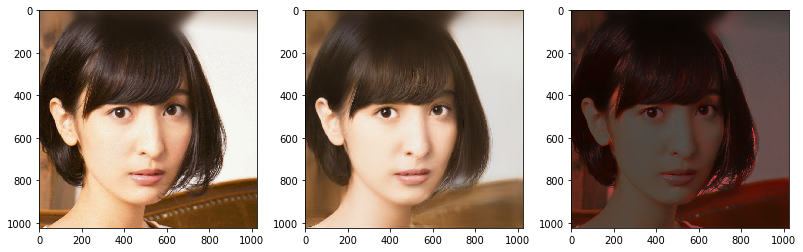

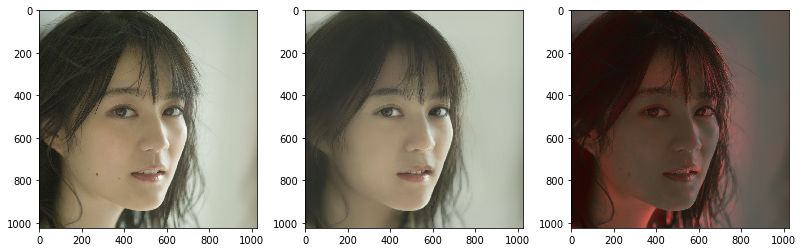

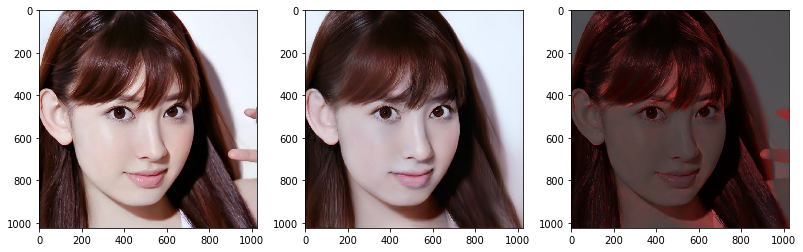

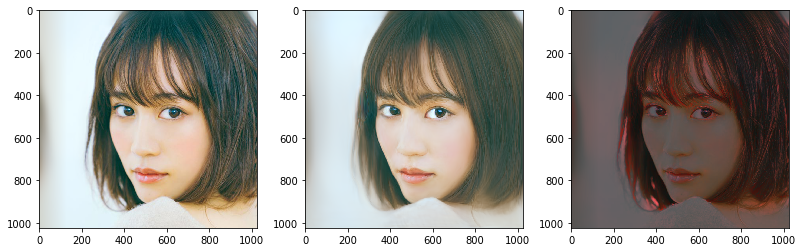

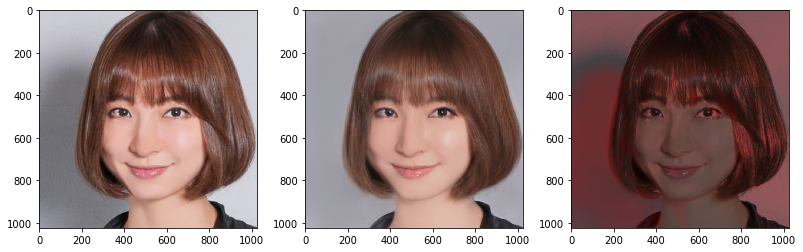

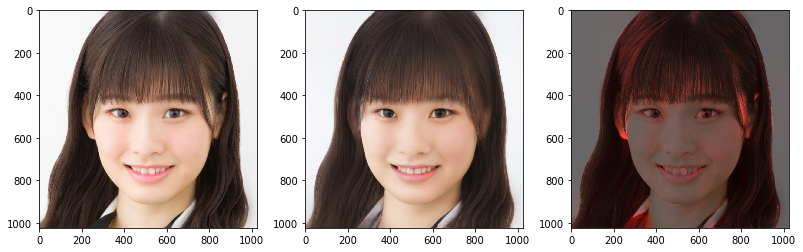

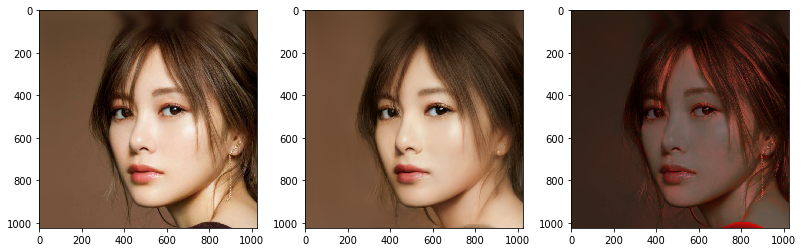

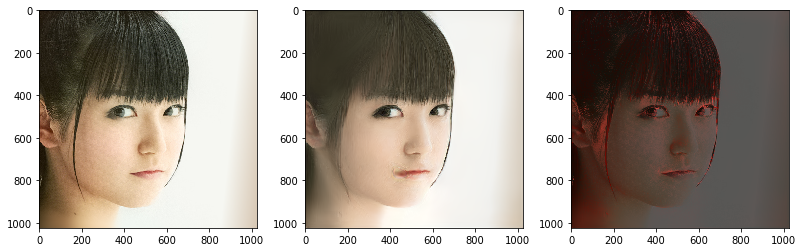

In [8]:
from plot_utils import ShowModelOutput
import torch
for Face, Z in zip(FaceData.Faces, FaceData.Zspace):
    Face = Face.unsqueeze(0)
    ModelOut = FaceModel(Z.unsqueeze(0).detach())
    ModelOut = (ModelOut.clamp(-1,1) + 1)/2
    
    PixelDiffs = abs(ModelOut - Face)
    PixelDiffs = PixelDiffs.sum(dim=1)
    
    Heatmap = Face.clone().detach()
    Heatmap[:,0,:,:] += PixelDiffs
    Heatmap = (Heatmap - Heatmap.min())/Heatmap.max()
    
    ShowModelOutput(torch.cat([Face, ModelOut,Heatmap], dim=0))

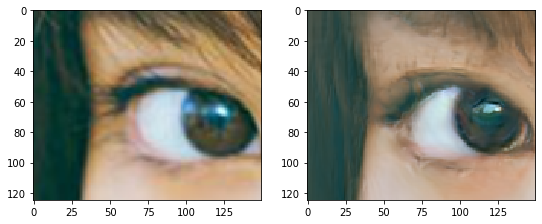

In [78]:
Face = FaceData.Faces[1].unsqueeze(0)
ModelOut = FaceModel(FaceData.Zspace[1].unsqueeze(0).detach())
ModelOut = (ModelOut.clamp(-1,1) + 1)/2


ShowModelOutput(torch.cat([Face[:,:,400:525,300:450], ModelOut[:,:,400:525,300:450]], dim=0))